<a href="https://colab.research.google.com/github/guilherminog/tcc_timeseries/blob/main/TCC_PUC_Walmart_sales_forecasting_notebook_Sarimax_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Previsão de Vendas de Lojas do Walmart
Este notebook aborda a previsão de vendas nas lojas do Walmart utilizando os modelos ARIMA e Regressão Linear. Inclui etapas de limpeza de dados, análise exploratória, e construção de modelos de aprendizado de máquina, seguindo a metodologia CRISP-DM.

## Intalação de bilbiotecas

In [119]:
!pip install statsmodels pmdarima prophet tbats shap


In [120]:
import sys
print("Python version:", sys.version)

Python version: 3.10.12 (main, Sep 11 2024, 15:47:36) [GCC 11.4.0]


## Importação das bibliotecas

In [211]:
import pandas as pd
import numpy as np
import matplotlib
import statsmodels
import sklearn
import tbats
import pmdarima
import tensorflow as tf
import keras
import torch
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
from matplotlib import pyplot as plt
import seaborn as sns

from statsmodels.tsa.arima.model import ARIMA
import statsmodels.api as sm

from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from sklearn.feature_selection import RFE
from sklearn.preprocessing import MinMaxScaler, StandardScaler


import shap
from tbats import TBATS
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.forecasting.theta import ThetaModel
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX

from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam

from prophet import Prophet

from pmdarima.arima import auto_arima

from warnings import filterwarnings

# Remover warnings
filterwarnings("ignore", category=FutureWarning)
filterwarnings("ignore", category=DeprecationWarning)
filterwarnings("ignore", category=UserWarning)
filterwarnings("ignore", category=RuntimeWarning)

In [122]:
plt.figure(figsize=(16,10))

<Figure size 1600x1000 with 0 Axes>

<Figure size 1600x1000 with 0 Axes>

In [123]:
# Exibir versões
print("Pandas:", pd.__version__)
print("Numpy:", np.__version__)
print("Matplotlib:", matplotlib.__version__)
print("Seaborn:", sns.__version__)
print("Statsmodels:", statsmodels.__version__)
print("Scikit-learn:", sklearn.__version__)
print("TBATS:", tbats.__version__)
print("Pmdarima:", pmdarima.__version__)
print("TensorFlow:", tf.__version__)
print("Keras:", keras.__version__)
print("Torch:", torch.__version__)

Pandas: 2.2.2
Numpy: 1.26.4
Matplotlib: 3.8.0
Seaborn: 0.13.2
Statsmodels: 0.14.4
Scikit-learn: 1.5.2
TBATS: 1.1.3
Pmdarima: 2.0.4
TensorFlow: 2.17.0
Keras: 3.4.1
Torch: 2.5.0+cu121


## Leitura dos dados

In [124]:
url = "https://raw.githubusercontent.com/guilherminog/tcc_timeseries/refs/heads/main/dataset/Walmart.csv"

df = pd.read_csv(url)
df_date = df.copy()
df['Date'] = pd.to_datetime(df['Date'], format='%d-%m-%Y')

In [125]:
df.sample(10)

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
1934,14,2011-07-15,1953544.76,0,78.47,3.760,186.139981,8.625
1088,8,2011-10-07,929976.55,0,67.61,3.285,220.477254,6.123
6213,44,2011-04-29,281247.97,0,43.85,3.683,128.999867,6.906
3014,22,2010-04-23,969594.47,0,51.04,2.895,135.872167,8.348
6096,43,2011-10-28,572516.57,0,66.82,3.372,209.369249,10.148
1803,13,2011-10-07,2067232.56,0,60.62,3.592,129.693800,6.392
1408,10,2012-06-01,1767471.48,0,80.06,4.277,130.959226,7.382
3442,25,2010-04-16,715311.60,0,52.16,2.899,203.730749,7.856
3439,25,2010-03-26,696687.60,0,45.84,2.854,204.201755,8.187
6003,42,2012-10-12,612379.90,0,76.03,4.468,131.108333,6.943


In [126]:
print(f'O dataset contém {df.shape[0]} linhas e {df.shape[1]} colunas.')

O dataset contém 6435 linhas e 8 colunas.


In [127]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6435 non-null   int64         
 1   Date          6435 non-null   datetime64[ns]
 2   Weekly_Sales  6435 non-null   float64       
 3   Holiday_Flag  6435 non-null   int64         
 4   Temperature   6435 non-null   float64       
 5   Fuel_Price    6435 non-null   float64       
 6   CPI           6435 non-null   float64       
 7   Unemployment  6435 non-null   float64       
dtypes: datetime64[ns](1), float64(5), int64(2)
memory usage: 402.3 KB


In [128]:
store = df['Store'].nunique()
print(f'O dataset contém {store} lojas.')

O dataset contém 45 lojas.


## Processamento/Tratamento de Dados

In [129]:
print(f'O dataset contém {df.isnull().sum().sum()} valores nulos.')

O dataset contém 0 valores nulos.


In [130]:
df.fillna(df.median(), inplace=True)

In [131]:
scaler = MinMaxScaler()
scaler.fit(df.select_dtypes(include='number'))

df_numerico = pd.DataFrame(scaler.inverse_transform(df.select_dtypes(include='number')), columns=df.select_dtypes(include='number').columns)
df_numerico.describe().T

,count,mean,std,min,25%,50%,75%,max
Store,6435.0,1.013000e+03,5.714800e+02,4.500000e+01,5.290000e+02,1.013000e+03,1.497000e+03,1.981000e+03
Weekly_Sales,6435.0,3.778183e+12,2.036630e+12,7.577776e+11,1.996875e+12,3.467045e+12,5.124927e+12,1.378049e+13
Holiday_Flag,6435.0,6.993007e-02,2.550489e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
Temperature,6435.0,6.197779e+03,1.885072e+03,-2.125920e+02,4.848352e+03,6.402814e+03,7.656808e+03,1.023225e+04
Fuel_Price,6435.0,9.175779e+00,9.162033e-01,7.406112e+00,8.326268e+00,9.348220e+00,9.927060e+00,1.139013e+01
CPI,6435.0,1.748445e+04,3.981672e+03,1.287981e+04,1.345354e+04,1.860116e+04,2.164905e+04,2.311494e+04
Unemployment,6435.0,8.734214e+01,1.957298e+01,4.435249e+01,7.577969e+01,8.603632e+01,9.384095e+01,1.532208e+02


## Análise Exploratoria de dados (EDA)

### Histogramas para variáveis numéricas

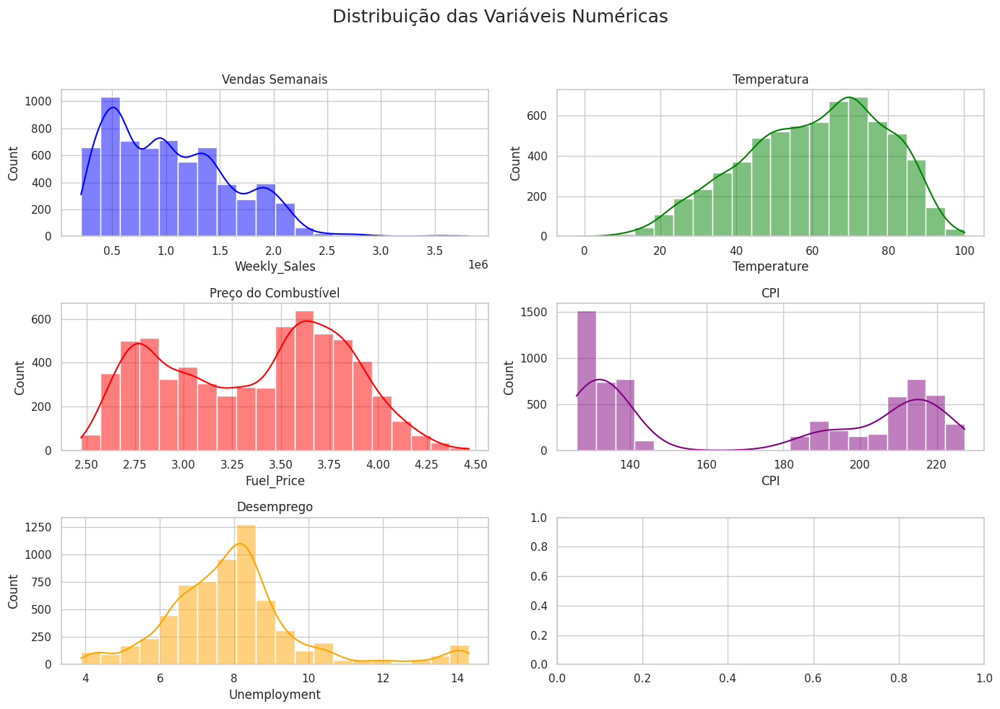

In [132]:
fig, axes = plt.subplots(3, 2, figsize=(14, 10))
fig.suptitle('Distribuição das Variáveis Numéricas', fontsize=18)

sns.histplot(df['Weekly_Sales'], bins=20, color='blue', kde=True, ax=axes[0, 0])
axes[0, 0].set_title('Vendas Semanais')

sns.histplot(df['Temperature'], bins=20, color='green', kde=True, ax=axes[0, 1])
axes[0, 1].set_title('Temperatura')

sns.histplot(df['Fuel_Price'], bins=20, color='red', kde=True, ax=axes[1, 0])
axes[1, 0].set_title('Preço do Combustível')

sns.histplot(df['CPI'], bins=20, color='purple', kde=True, ax=axes[1, 1])
axes[1, 1].set_title('CPI')

sns.histplot(df['Unemployment'], bins=20, color='orange', kde=True, ax=axes[2, 0])
axes[2, 0].set_title('Desemprego')

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

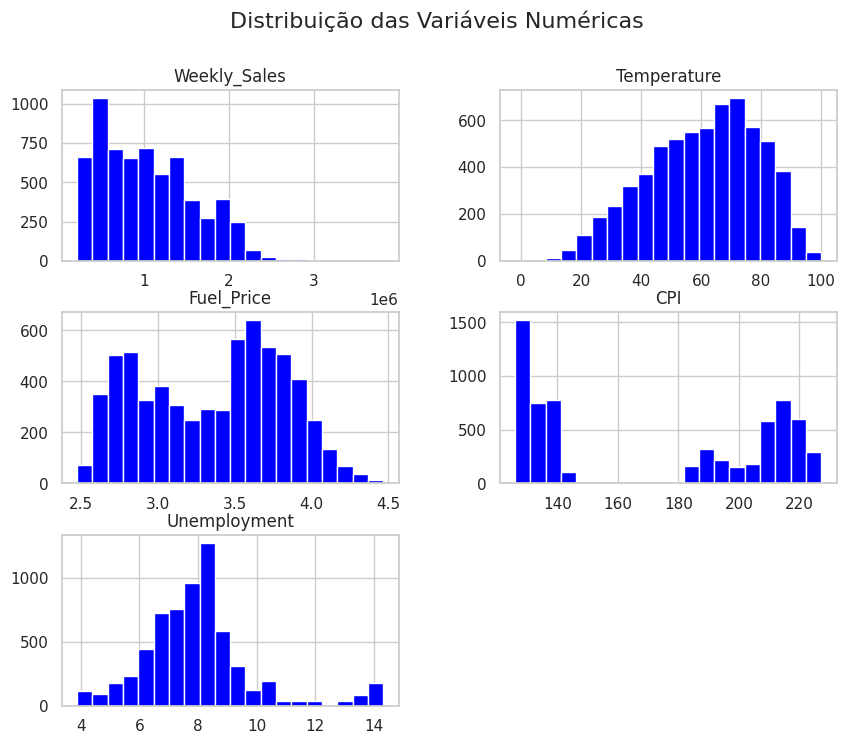

In [133]:
df[['Weekly_Sales', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']].hist(figsize=(10,8), bins=20, color='blue')
plt.suptitle('Distribuição das Variáveis Numéricas', fontsize=16)
plt.show()

### Análise Univariada
- Gráfico de boxplot para visualizar outliers

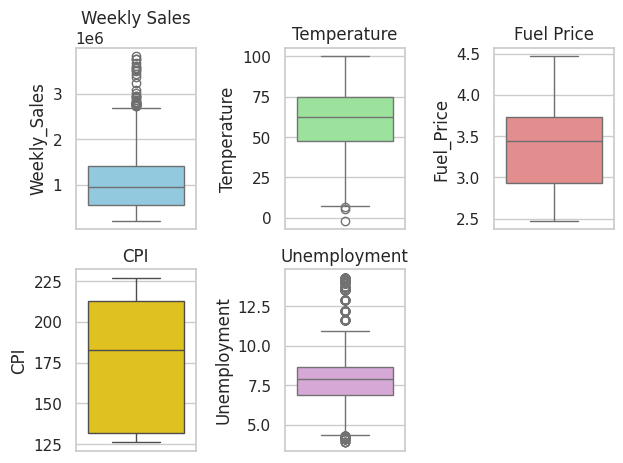

In [134]:
plt.subplot(2, 3, 1)
sns.boxplot(y=df['Weekly_Sales'], color='skyblue')
plt.title('Weekly Sales')

plt.subplot(2, 3, 2)
sns.boxplot(y=df['Temperature'], color='lightgreen')
plt.title('Temperature')

plt.subplot(2, 3, 3)
sns.boxplot(y=df['Fuel_Price'], color='lightcoral')
plt.title('Fuel Price')

plt.subplot(2, 3, 4)
sns.boxplot(y=df['CPI'], color='gold')
plt.title('CPI')

plt.subplot(2, 3, 5)
sns.boxplot(y=df['Unemployment'], color='plum')
plt.title('Unemployment')

plt.tight_layout()
plt.show()

**Por se tratar de dados reais os são outliers legítimos, nesse caso os outliers representam eventos reais, como picos de vendas durante a eventos como feriados outros adventos que podem ocorrer durante o ano.**

### Análise Bivariada/Multivariada
- Matriz de correlação
- Scatterplot para verificar relação entre duas variáveis

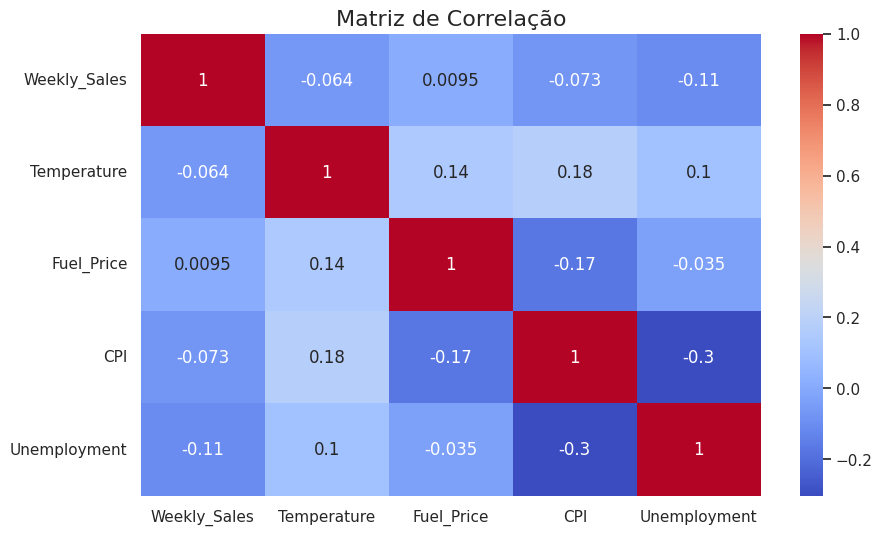

In [135]:
plt.figure(figsize=(10,6))
correlation_matrix = df[['Weekly_Sales', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de Correlação', fontsize=16)
plt.show()

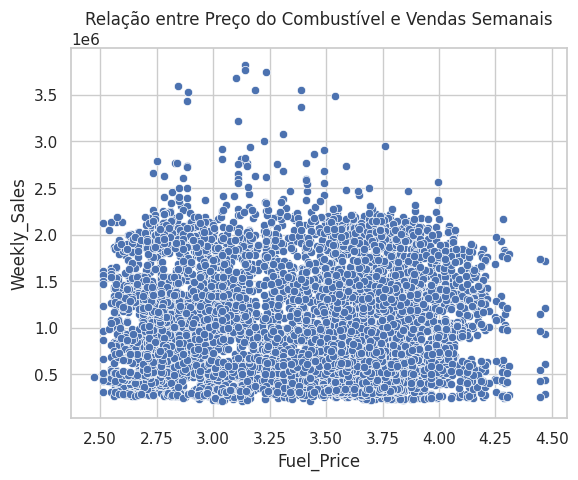

In [136]:
sns.scatterplot(x='Fuel_Price', y='Weekly_Sales', data=df)
plt.title('Relação entre Preço do Combustível e Vendas Semanais')
plt.show()

**Distribuição Difusa:**

- A dispersão dos pontos sugere que não há uma correlação clara entre o preço do combustível e as vendas semanais.
As vendas permanecem relativamente estáveis, mesmo com variações no preço do combustível, indicando uma baixa sensibilidade das vendas a essa variável.

**Outliers Notáveis:**

- Há alguns pontos fora do padrão, especialmente em vendas acima de 3 milhões. Estes outliers podem estar associados a eventos especiais ou promoções que não são diretamente influenciados pelo preço do combustível.


**Conclusão:**
- A análise indica que o preço do combustível não influencia fortemente as vendas semanais.
Recomendo explorar outras variáveis, como temperatura, CPI e indicadores econômicos, para identificar fatores que possam ter uma correlação mais significativa com as vendas.

### Pivot
- Pivot para calcular a média de vendas semanais por loja e por feriado
- Visualizando o pivot com um gráfico de barras

In [137]:
pivot_table = df.pivot_table(values='Weekly_Sales', index='Store', columns='Holiday_Flag', aggfunc='mean')
pivot_table

Holiday_Flag,0,1
Store,,
1,1.546957e+06,1665747.656
2,1.914209e+06,2079266.900
3,4.000648e+05,437811.050
4,2.083556e+06,2243102.624
5,3.148923e+05,359501.607
6,1.555993e+06,1680907.927
7,5.629645e+05,672400.265
8,9.037434e+05,975330.860
9,5.405993e+05,588950.821


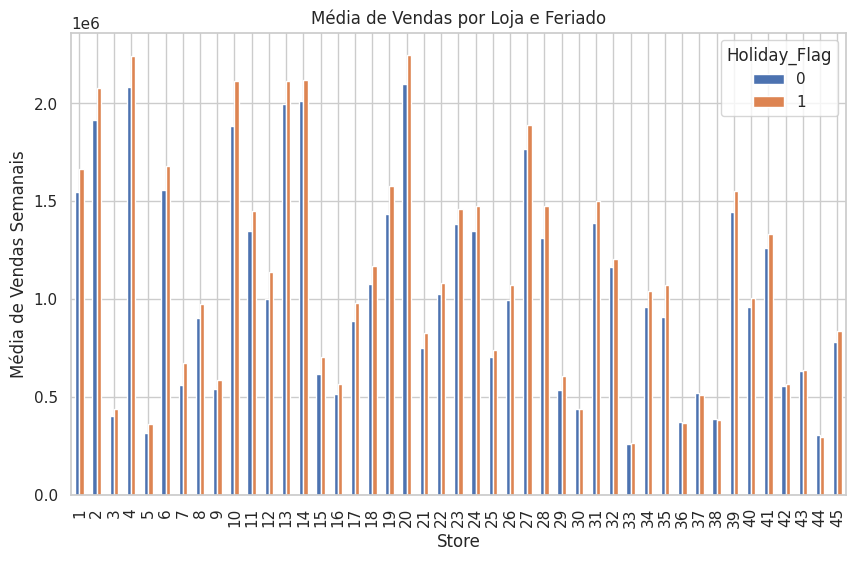

In [138]:
pivot_table.plot(kind='bar', figsize=(10,6))
plt.title('Média de Vendas por Loja e Feriado')
plt.ylabel('Média de Vendas Semanais')
plt.show()

#### <b>Análise de Performance das Lojas</b>

Analisando o gráfico que apresenta a média de vendas semanais por loja, podemos identificar as lojas que melhor performaram ao longo do período analisado, tanto em períodos normais quanto durante os feriados:

1. **Loja 20**: Esta loja se destaca com a maior média de vendas semanais, especialmente durante os períodos de feriado (Holiday Flag = 1). Ela apresenta um desempenho significativamente superior em comparação com as outras lojas.

2. **Loja 4**: Também apresenta um ótimo desempenho, com médias de vendas semanais bastante altas, tanto nos períodos normais quanto durante os feriados.

3. **Loja 2**: Outra loja que se destaca no gráfico, com boas vendas semanais em ambos os contextos, o que demonstra uma boa performance.

Essas três lojas têm um desempenho superior em termos de média de vendas semanais, o que indica uma operação eficiente e com alta demanda, tanto em períodos comuns quanto em feriados.


In [139]:
df.columns

Index(['Store', 'Date', 'Weekly_Sales', 'Holiday_Flag', 'Temperature',
       'Fuel_Price', 'CPI', 'Unemployment'],
      dtype='object')

In [140]:
df['Date'] = pd.to_datetime(df['Date'])
df['week'] = df['Date'].dt.isocalendar().week
df['year'] = df['Date'].dt.year
df['month'] = df['Date'].dt.month

# Agrupar dados por semana e loja
vendas_semanais = df.groupby(['week', 'Store'])['Weekly_Sales'].sum().reset_index()

# Encontrar a loja com maior venda em cada semana
maior_venda_por_semana = vendas_semanais.loc[vendas_semanais.groupby('week')['Weekly_Sales'].idxmax()]

# Exibir o DataFrame com as maiores vendas por semana
print("Tabela de Lojas com Maiores Vendas por Semana:")
print(maior_venda_por_semana)


Tabela de Lojas com Maiores Vendas por Semana:
      week  Store  Weekly_Sales
3        1      4    3910242.34
48       2      4    3807179.07
93       3      4    3891491.70
138      4      4    3742961.36
199      5     20    6956061.74
244      6     20    6783474.32
273      7      4    6793995.99
318      8      4    6230485.70
379      9     20    6411461.09
424     10     20    6141173.01
453     11      4    6228872.18
508     12     14    5823295.21
559     13     20    6408110.05
598     14     14    6672602.42
649     15     20    6088586.98
688     16     14    6270292.74
733     17     14    5797002.71
778     18     14    6415070.74
829     19     20    6238057.26
858     20      4    6126530.89
913     21     14    6338716.01
964     22     20    6528992.63
1003    23     14    6481631.92
1054    24     20    6322255.19
1092    25     13    6073876.33
1144    26     20    6252794.79
1189    27     20    6589128.94
1234    28     20    6206408.03
1263    29      4    6060

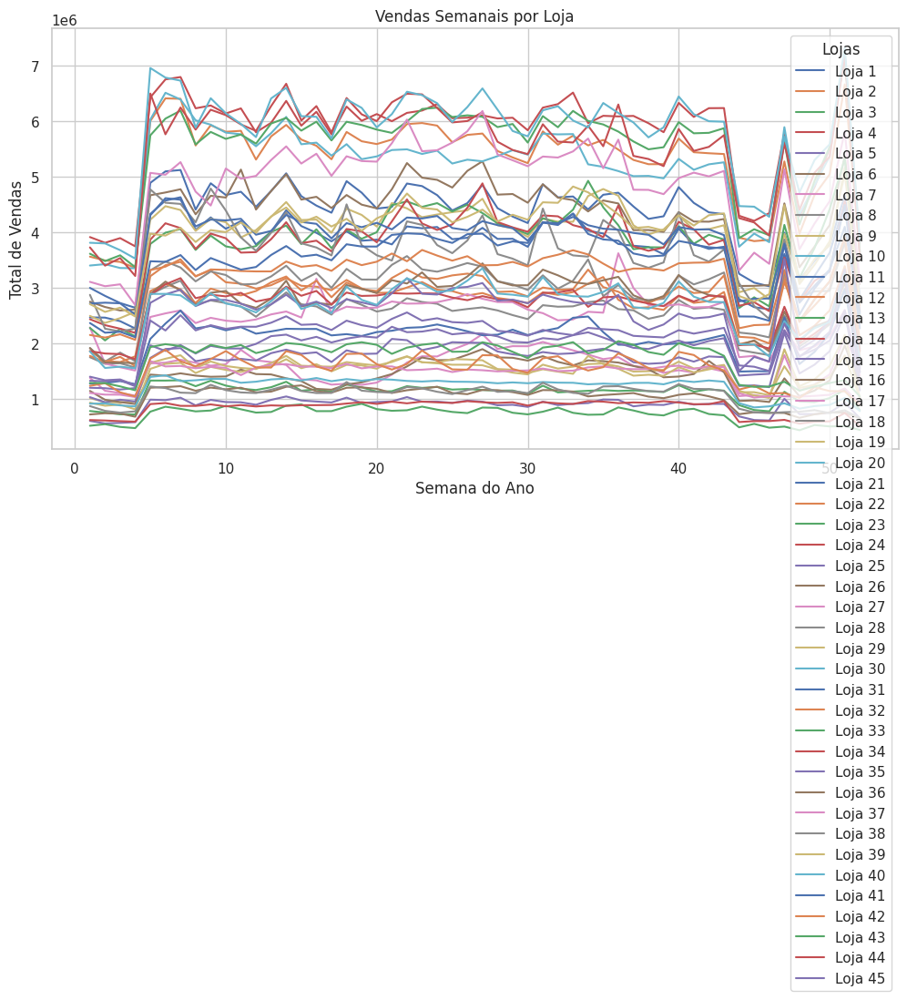

In [141]:
# Plotar gráfico de vendas semanais por loja
plt.figure(figsize=(12, 6))
for store in vendas_semanais['Store'].unique():
    loja_data = vendas_semanais[vendas_semanais['Store'] == store]
    plt.plot(loja_data['week'], loja_data['Weekly_Sales'], label=f"Loja {store}")

plt.title('Vendas Semanais por Loja')
plt.xlabel('Semana do Ano')
plt.ylabel('Total de Vendas')
plt.legend(title='Lojas')
plt.show()

O gráfico acima mostra as vendas semanais de todas as lojas ao longo de um ano. Observa-se um pico acentuado de vendas nas primeiras semanas e outro próximo ao final do ano, provavelmente devido a eventos sazonais como Ano Novo e Natal. No restante do ano, as vendas são relativamente estáveis, mas com variações entre as lojas, sugerindo diferenças regionais ou de estratégias de marketing.

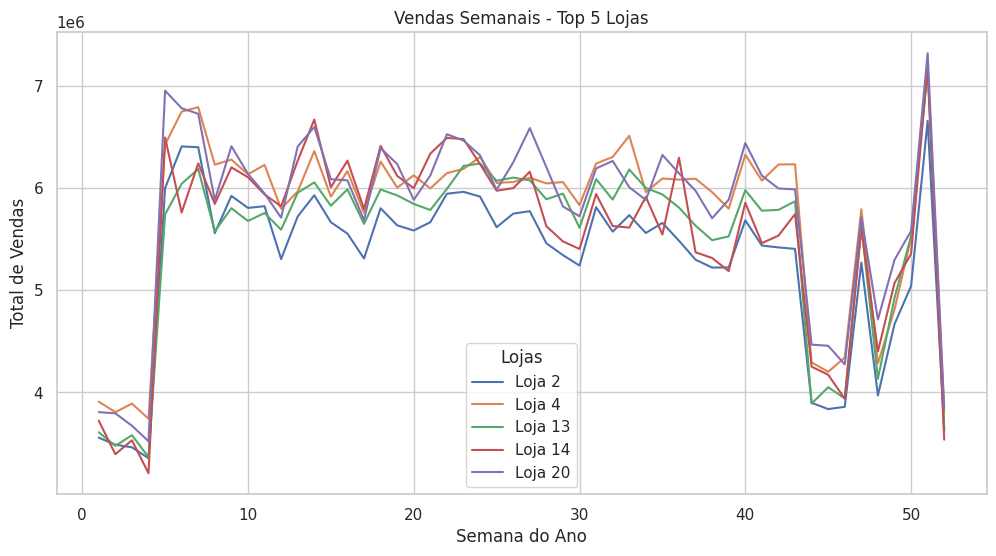

In [142]:
# Calcular o total de vendas por loja
vendas_por_loja = vendas_semanais.groupby('Store')['Weekly_Sales'].sum().nlargest(5).index

# Filtrar o DataFrame para incluir apenas as Top 5 lojas
top5_vendas_semanais = vendas_semanais[vendas_semanais['Store'].isin(vendas_por_loja)]

# Plotar o gráfico para as Top 5 lojas
plt.figure(figsize=(12, 6))
for store in top5_vendas_semanais['Store'].unique():
    loja_data = top5_vendas_semanais[top5_vendas_semanais['Store'] == store]
    plt.plot(loja_data['week'], loja_data['Weekly_Sales'], label=f"Loja {store}")

plt.title('Vendas Semanais - Top 5 Lojas')
plt.xlabel('Semana do Ano')
plt.ylabel('Total de Vendas')
plt.legend(title='Lojas')
plt.grid(True)
plt.show()


### Análise do Gráfico de Vendas Semanais - Top 5 Lojas

O gráfico mostra as vendas semanais das 5 lojas com maior volume de vendas ao longo de um ano. Vamos detalhar algumas observações e insights que podemos tirar dessa visualização:

#### 1. **Picos de Vendas nas Semanas 1 e 50:**
- Há um pico acentuado de vendas logo no início do ano (semana 1) e outro pico significativo próximo ao final do ano (semana 50).
- Esses picos provavelmente estão associados a eventos sazonais, como **Ano Novo** e **Natal**, que geralmente impulsionam as vendas no varejo.

#### 2. **Variação Relativamente Estável no Meio do Ano:**
- Entre as semanas 10 e 40, as vendas parecem ser mais estáveis, com menos flutuações drásticas.
- Esse período de estabilidade pode indicar um comportamento regular de consumo, sem grandes eventos ou promoções.

#### 3. **Queda Notável nas Semanas 45 a 50:**
- Há uma queda perceptível nas vendas antes do pico final do ano (semana 50). Isso pode indicar uma preparação para grandes promoções de final de ano, como a **Black Friday**, onde os consumidores podem adiar suas compras à espera de melhores preços.

#### 4. **Diferença Entre as Lojas:**
- A loja **2** se destaca com um volume de vendas ligeiramente superior em comparação às outras, especialmente nos períodos de pico.
- As lojas **4**, **14**, e **20** apresentam um comportamento muito semelhante ao longo do tempo, sugerindo que podem estar em regiões ou mercados similares.
- A loja **13** mostra um comportamento mais variável, com flutuações mais acentuadas nas vendas, o que pode indicar uma maior sensibilidade a promoções ou eventos locais.

#### 5. **Tendência Geral de Crescimento no Início do Ano:**
- Observa-se uma tendência de crescimento acentuado nas vendas logo nas primeiras semanas, indicando um período de forte demanda, possivelmente relacionado ao período pós-feriado.

### Conclusão:
- As lojas analisadas apresentam padrões de vendas bastante similares, mas com algumas diferenças nos picos, sugerindo que as estratégias de marketing e promoções sazonais são bastante eficazes para todas as lojas.
- Para uma análise mais detalhada, seria interessante verificar os impactos das variáveis externas (como preço do combustível e CPI) nas vendas, bem como analisar se eventos como feriados influenciam significativamente as flutuações observadas.

Se quiser, podemos explorar mais esses dados, analisando outras variáveis ou aplicando modelos de previsão para identificar padrões futuros.

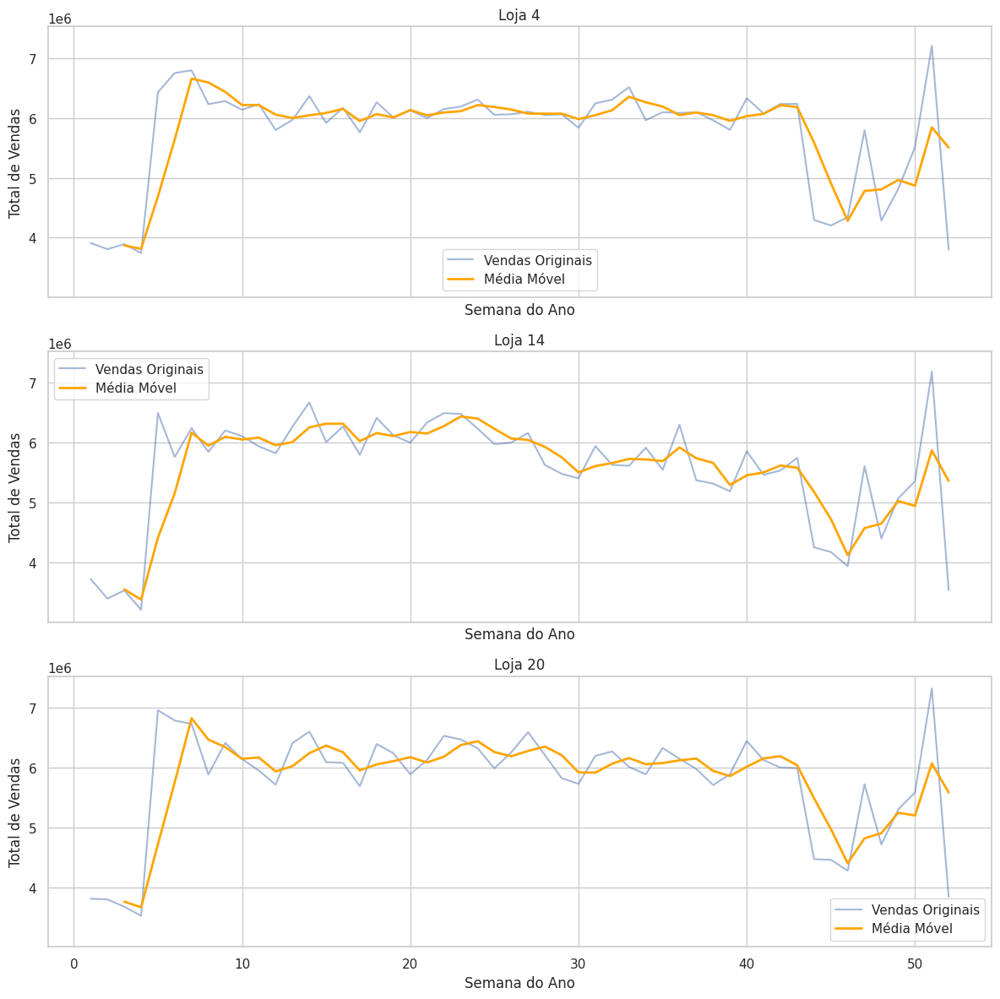

In [143]:
# Calcular o total de vendas por loja e selecionar as Top 3
top3_lojas = vendas_semanais.groupby('Store')['Weekly_Sales'].sum().nlargest(3).index

# Filtrar o DataFrame para incluir apenas as Top 3 lojas
top3_vendas_semanais = vendas_semanais[vendas_semanais['Store'].isin(top3_lojas)]

# Criar 3 subplots para as Top 3 lojas
fig, axs = plt.subplots(3, 1, figsize=(12, 12), sharex=True, sharey=True)

for i, store in enumerate(top3_vendas_semanais['Store'].unique()):
    loja_data = top3_vendas_semanais[top3_vendas_semanais['Store'] == store]
    loja_data = loja_data.sort_values(by='week')

    # Aplicar média móvel para suavizar a linha (janela de 3 semanas)
    loja_data['Weekly_Sales_Smoothed'] = loja_data['Weekly_Sales'].rolling(window=3).mean()

    # Plotar dados originais e suavizados
    axs[i].plot(loja_data['week'], loja_data['Weekly_Sales'], label='Vendas Originais', alpha=0.5)
    axs[i].plot(loja_data['week'], loja_data['Weekly_Sales_Smoothed'], label='Média Móvel', linewidth=2, color='orange')

    axs[i].set_title(f"Loja {store}")
    axs[i].set_xlabel('Semana do Ano')
    axs[i].set_ylabel('Total de Vendas')
    axs[i].grid(True)
    axs[i].legend()

# Ajustar layout e exibir o gráfico
plt.tight_layout()
plt.show()


**O gráfico apresenta a análise de vendas semanais para as lojas 4, 14 e 20 com linhas suavizadas usando uma média móvel.**

### Análise Breve:
1. **Tendência Geral:**
   - As três lojas seguem um padrão semelhante, com picos de vendas nas primeiras semanas e na reta final do ano.
   - Entre as semanas 10 e 40, as vendas são mais estáveis, indicando uma demanda regular.

2. **Impacto da Sazonalidade:**
   - Picos acentuados nas primeiras semanas indicam alta demanda pós-feriado.
   - As quedas nas semanas 45 a 50 sugerem uma preparação para o aumento das vendas no fim de ano, possivelmente devido à Black Friday e Natal.

3. **Comportamento Suavizado:**
   - A linha de média móvel mostra uma tendência mais estável e ajuda a destacar a sazonalidade e os períodos de alta/baixa demanda.

Essas lojas parecem ser influenciadas por fatores sazonais semelhantes e apresentam um comportamento consistente ao longo do ano.

### Análise do Impacto da Variação do Preço do Combustível sobre as Vendas Semanais

   Fuel_Price  Fuel_Price_norm
0       2.572         0.050100
1       2.548         0.038076
2       2.514         0.021042
3       2.561         0.044589
4       2.625         0.076653


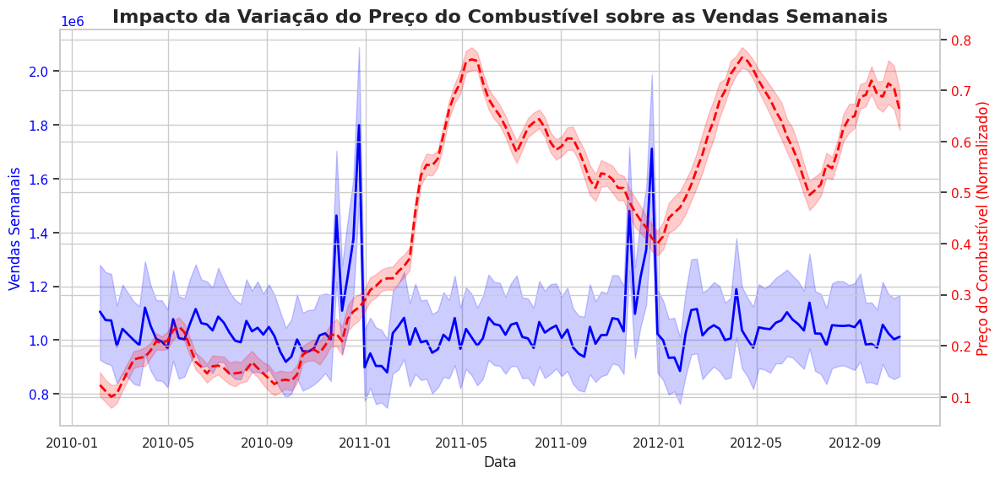

In [144]:
df_fuel = df.copy()

# Normalizar a coluna 'Fuel_Price' na cópia do DataFrame
scaler = MinMaxScaler()
df_fuel['Fuel_Price_norm'] = scaler.fit_transform(df_fuel[['Fuel_Price']])

# Verificar se a normalização foi aplicada corretamente
print(df_fuel[['Fuel_Price', 'Fuel_Price_norm']].head())

# Plotagem
sns.set(style="whitegrid")

fig, ax1 = plt.subplots(figsize=(12, 6))

# Plotar Vendas Semanais
ax1.set_xlabel('Data', fontsize=12)
ax1.set_ylabel('Vendas Semanais', fontsize=12, color='blue')
sns.lineplot(data=df_fuel, x='Date', y='Weekly_Sales', color='blue', linewidth=2, ax=ax1)
ax1.tick_params(axis='y', labelcolor='blue')

# Plotar Preço do Combustível Normalizado
ax2 = ax1.twinx()
ax2.set_ylabel('Preço do Combustível (Normalizado)', fontsize=12, color='red')
sns.lineplot(data=df_fuel, x='Date', y='Fuel_Price_norm', color='red', linewidth=2, linestyle='--', ax=ax2)
ax2.tick_params(axis='y', labelcolor='red')

plt.title('Impacto da Variação do Preço do Combustível sobre as Vendas Semanais', fontsize=16, weight='bold')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#### <b>Análise do Impacto da Variação do Preço do Combustível sobre as Vendas Semanais</b>

#### <b>Análise:</b>

1. **Tendências Gerais**:
   - As vendas semanais (linha azul) apresentam um comportamento relativamente estável, exceto por picos sazonais bastante definidos, com destaque para o final de 2010 e início de 2011, onde observamos grandes aumentos. Esses picos parecem estar alinhados com eventos como feriados e datas comemorativas, que geralmente impulsionam as vendas.

2. **Variação do Preço do Combustível**:
   - A linha vermelha (preço do combustível normalizado) mostra uma tendência de aumento contínuo desde o início de 2010 até meados de 2011, quando o preço do combustível começa a cair ligeiramente. Apesar de uma leve queda em 2011, o preço do combustível retoma uma trajetória ascendente no final de 2011 e início de 2012.
   
3. **Impacto do Preço do Combustível sobre as Vendas**:
   - Há uma relação visível, mas não direta, entre o aumento do preço do combustível e as vendas semanais. O aumento no preço do combustível parece não ter um impacto imediato nas vendas, uma vez que os picos de vendas não coincidem diretamente com os aumentos mais fortes no preço do combustível.
   - No entanto, ao observarmos os períodos em que o preço do combustível se mantém estável (como no final de 2010 e final de 2011), as vendas também parecem estabilizar em níveis semelhantes. Isso pode sugerir que um combustível mais barato favorece a manutenção ou até mesmo o leve aumento das vendas.

4. **Desconexão entre picos de vendas e preço do combustível**:
   - Um aspecto notável é que os maiores picos de vendas semanais (entre o final de 2010 e o início de 2011) ocorrem em momentos em que o preço do combustível está subindo ou estável. Isso pode sugerir que outros fatores (como promoções ou eventos de feriados) são mais determinantes para impulsionar as vendas do que a variação no preço do combustível.
   
5. **Estabilidade em Períodos de Alta no Preço do Combustível**:
   - Quando o preço do combustível está mais alto, a partir de meados de 2011, as vendas semanais tendem a se manter mais constantes, sem grandes flutuações, exceto nos momentos de queda acentuada no início de 2012, quando o combustível também apresenta ligeira queda. Esse padrão reforça a ideia de que, em situações onde o combustível está mais caro, os consumidores podem ter menos poder de compra, o que impacta as vendas.

### Conclusão:

- **Correlação moderada**: Apesar de não haver uma correlação imediata e direta entre o aumento do preço do combustível e as vendas, há indícios de que períodos de queda ou estabilidade no preço do combustível ajudam a manter as vendas em níveis mais elevados e estáveis.
  
- **Influência de fatores sazonais**: Fatores como datas comemorativas ou promoções parecem ter um impacto mais direto sobre as vendas do que o preço do combustível, sugerindo que o comportamento do consumidor pode ser mais sensível a esses eventos.
  
- **Relação inversa em certos momentos**: Quando o preço do combustível sobe, as vendas tendem a se estabilizar ou apresentar leve queda, o que pode sugerir que o aumento nos custos do combustível impacta o orçamento das famílias e, consequentemente, o poder de compra.

Em resumo, o preço do combustível tem uma influência moderada, mas não dominante, sobre as vendas. O comportamento do consumidor é mais fortemente influenciado por eventos sazonais e picos de demanda do que pela variação no preço do combustível.


## Correlação de pearson
- Apesar de sedr o ideal inclui STORE nessa nova correlação


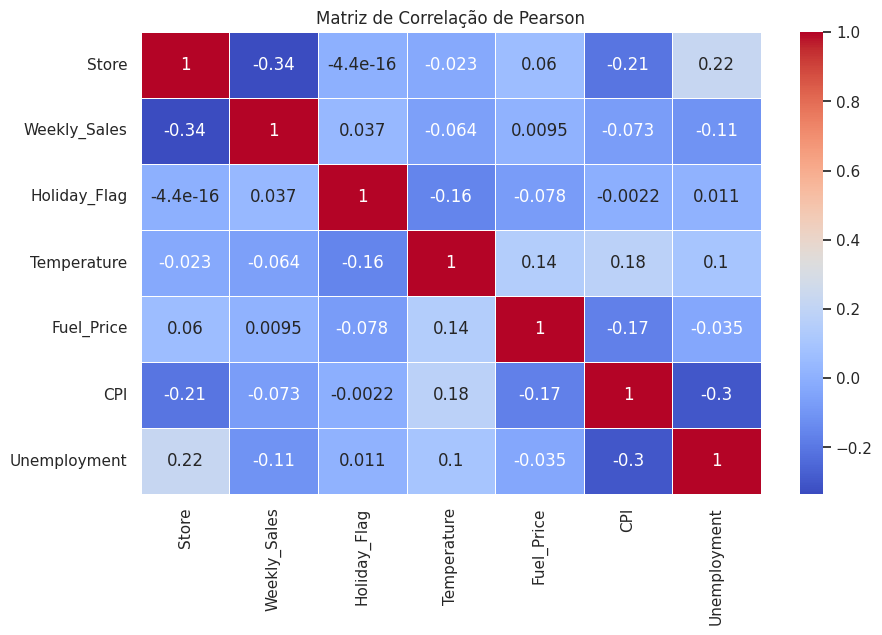

In [145]:
numeric_features = ['Store', 'Weekly_Sales', 'Holiday_Flag', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']

# Calcular a matriz de correlação de Pearson para todas as features numéricas
pearson_correlation = df[numeric_features].corr(method='pearson')

# Plotar o heatmap da correlação
plt.figure(figsize=(10, 6))
sns.heatmap(pearson_correlation, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title("Matriz de Correlação de Pearson")
plt.show()



## Feature Engineering

In [146]:
df.columns

Index(['Store', 'Date', 'Weekly_Sales', 'Holiday_Flag', 'Temperature',
       'Fuel_Price', 'CPI', 'Unemployment', 'week', 'year', 'month'],
      dtype='object')

In [147]:
df['Month'] = df['Date'].dt.month
df['Year'] = df['Date'].dt.year
df['Week'] = df['Date'].dt.isocalendar().week

In [148]:
df[['Date', 'Weekly_Sales', 'Month', 'Year', 'Week']].head()

,Date,Weekly_Sales,Month,Year,Week
0,2010-02-05,1643690.90,2,2010,5
1,2010-02-12,1641957.44,2,2010,6
2,2010-02-19,1611968.17,2,2010,7
3,2010-02-26,1409727.59,2,2010,8
4,2010-03-05,1554806.68,3,2010,9


## Analisando as 3 lojas com melhor performance


In [149]:
df_fuel = df.copy()

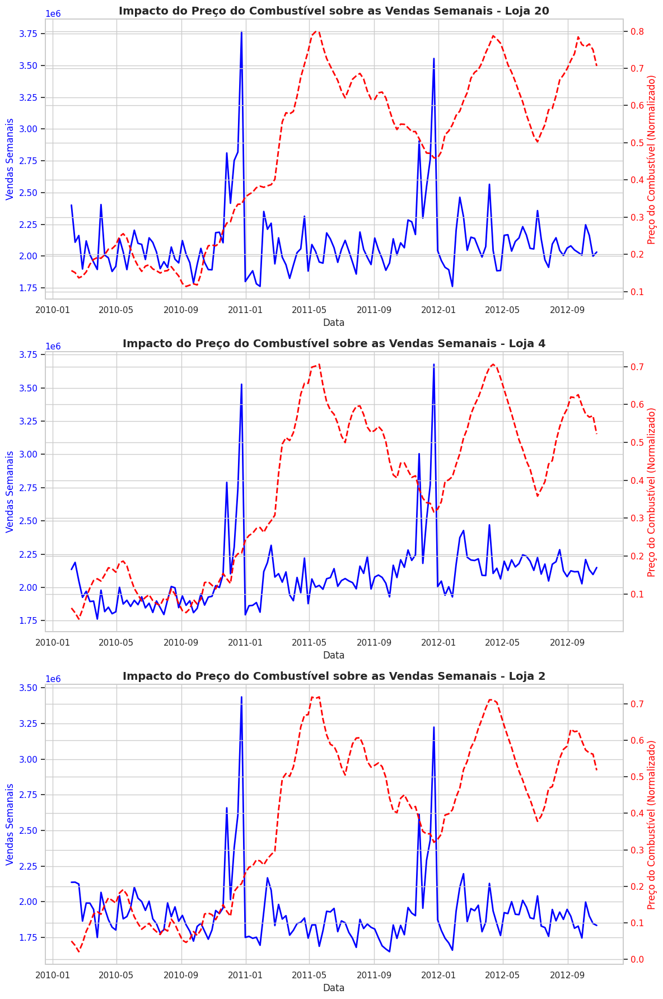

In [150]:
# Normalizar o preço do combustível
scaler = MinMaxScaler()
df['Fuel_Price_norm'] = scaler.fit_transform(df[['Fuel_Price']])

sns.set(style="whitegrid")

# Definindo as melhores lojas
melhores_lojas = ['20', '4', '2']
df_melhores_lojas = df[df['Store'].isin([int(loja) for loja in melhores_lojas])]

# Criar os subplots
fig, axs = plt.subplots(len(melhores_lojas), figsize=(12, 18))

# Iterar sobre cada loja e gerar os gráficos
for i, loja in enumerate(melhores_lojas):
    # Selecionar os dados da loja
    vendas_loja = df_melhores_lojas[df_melhores_lojas['Store'] == int(loja)]

    # Plotar as vendas semanais
    ax1 = axs[i]
    ax1.set_xlabel('Data', fontsize=12)
    ax1.set_ylabel('Vendas Semanais', fontsize=12, color='blue')
    sns.lineplot(data=vendas_loja, x='Date', y='Weekly_Sales', color='blue', linewidth=2, ax=ax1)
    ax1.tick_params(axis='y', labelcolor='blue')

    # Criar o segundo eixo para o preço do combustível normalizado
    ax2 = ax1.twinx()
    ax2.set_ylabel('Preço do Combustível (Normalizado)', fontsize=12, color='red')
    sns.lineplot(data=vendas_loja, x='Date', y='Fuel_Price_norm', color='red', linewidth=2, linestyle='--', ax=ax2)
    ax2.tick_params(axis='y', labelcolor='red')

    # Definir o título do subplot para cada loja
    ax1.set_title(f'Impacto do Preço do Combustível sobre as Vendas Semanais - Loja {loja}', fontsize=14, weight='bold')

# Ajustar o layout
plt.tight_layout()

# Exibir o gráfico
plt.show()


#### <b>Análise dos Gráficos: Impacto do Preço do Combustível sobre as Vendas Semanais</b>

Os gráficos apresentados para as lojas 20, 4, e 2 mostram a relação entre o preço do combustível (normalizado) e as vendas semanais ao longo do tempo. A análise permite tirar alguns insights importantes sobre a dinâmica entre essas variáveis:

1. **Variação Sazonal**:
   - As três lojas apresentam picos de vendas semanais em períodos semelhantes, indicando uma possível sazonalidade nas vendas, com picos mais evidentes em torno dos meses de final de ano (especialmente no final de 2010 e 2011).
   - O preço do combustível parece seguir uma tendência mais estável e crescente ao longo do tempo, com algumas flutuações periódicas. O aumento do preço do combustível não necessariamente coincide com grandes quedas nas vendas, indicando que, para essas lojas, o impacto direto pode não ser tão pronunciado.

2. **Loja 20**:
   - A loja 20 tem vendas semanais mais consistentes e elevadas, com picos acentuados. Durante os momentos de aumento significativo do preço do combustível, as vendas não parecem ser fortemente impactadas, sugerindo que outros fatores (como a sazonalidade ou promoções) podem ter maior influência sobre as vendas.

3. **Loja 4**:
   - A loja 4 apresenta uma dinâmica similar à loja 20, com picos significativos nas vendas, especialmente em torno de dezembro de 2010 e 2011. No entanto, após cada pico de vendas, há uma queda abrupta, que coincide com o aumento do preço do combustível. Isso pode indicar que, para essa loja, o preço do combustível tem um impacto mais perceptível em períodos de baixa.

4. **Loja 2**:
   - A loja 2 mostra um padrão de vendas mais irregular, com picos e quedas mais frequentes. A relação entre o preço do combustível e as vendas não é tão clara, mas em alguns momentos, como em meados de 2011, é possível observar uma correlação inversa, onde o aumento do preço do combustível coincide com uma queda nas vendas.

### Conclusões:
- **Impacto do preço do combustível**: De maneira geral, o preço do combustível parece ter um efeito mais indireto sobre as vendas. As lojas 20 e 4 mostram maior resiliência a essas variações, enquanto a loja 2 apresenta uma correlação mais evidente entre o aumento do preço do combustível e a redução nas vendas.
- **Fatores externos e sazonalidade**: O impacto do preço do combustível pode ser suprimido por outros fatores como sazonalidade, especialmente em períodos de alta demanda (fim de ano, feriados).
- **Resiliência das lojas**: As lojas que apresentam maior resiliência a mudanças no preço do combustível podem estar localizadas em regiões onde os consumidores são menos sensíveis ao preço de combustíveis, ou podem ter outras estratégias que mantêm as vendas estáveis.


## Análise Comparativa Multivariada por Loja
Verificando a relação entre as features e as lojas separadas.


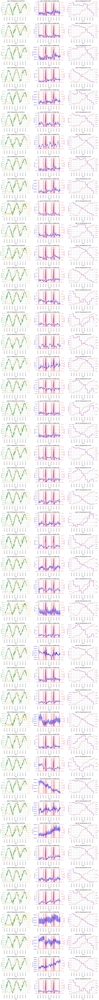

In [151]:
sns.set(style="whitegrid")

# Obter a lista de lojas únicas
lojas = df['Store'].unique()

# Definir o tamanho da figura e o layout dos subplots
fig, axs = plt.subplots(len(lojas), 3, figsize=(18, len(lojas) * 4))

# Iterar sobre cada loja
for i, loja in enumerate(lojas):
    # Filtrar os dados para a loja atual
    df_loja = df[df['Store'] == loja]

    # Gráfico 1: Temperature x Fuel_Price
    sns.lineplot(data=df_loja, x='Date', y='Temperature', color='green', linewidth=2, ax=axs[i, 0])
    axs[i, 0].set_ylabel('Temperature', fontsize=10, color='green')
    axs[i, 0].tick_params(axis='y', labelcolor='green')
    axs[i, 0].tick_params(axis='x', rotation=90)
    ax2 = axs[i, 0].twinx()
    sns.lineplot(data=df_loja, x='Date', y='Fuel_Price', color='orange', linewidth=2, linestyle='--', ax=ax2)
    ax2.set_ylabel('Fuel Price', fontsize=10, color='orange')
    ax2.tick_params(axis='y', labelcolor='orange')

    axs[i, 0].set_title(f'Loja {loja}: Temperature vs Fuel Price', fontsize=12, weight='bold')

    # Gráfico 2: Weekly_Sales x Holiday_Flag
    sns.lineplot(data=df_loja, x='Date', y='Weekly_Sales', color='blue', linewidth=2, ax=axs[i, 1])
    axs[i, 1].set_ylabel('Weekly Sales', fontsize=10, color='blue')
    axs[i, 1].tick_params(axis='y', labelcolor='blue')
    axs[i, 1].tick_params(axis='x', rotation=90)
    ax2 = axs[i, 1].twinx()
    sns.lineplot(data=df_loja, x='Date', y='Holiday_Flag', color='red', linewidth=2, linestyle='--', ax=ax2)
    ax2.set_ylabel('Holiday Flag', fontsize=10, color='red')
    ax2.tick_params(axis='y', labelcolor='red')

    axs[i, 1].set_title(f'Loja {loja}: Weekly Sales vs Holiday Flag', fontsize=12, weight='bold')

    # Gráfico 3: Unemployment x CPI
    sns.lineplot(data=df_loja, x='Date', y='Unemployment', color='purple', linewidth=2, ax=axs[i, 2])
    axs[i, 2].set_ylabel('Unemployment', fontsize=10, color='purple')
    axs[i, 2].tick_params(axis='y', labelcolor='purple')
    axs[i, 2].tick_params(axis='x', rotation=90)
    ax2 = axs[i, 2].twinx()
    sns.lineplot(data=df_loja, x='Date', y='CPI', color='brown', linewidth=2, linestyle='--', ax=ax2)
    ax2.set_ylabel('CPI', fontsize=10, color='brown')
    ax2.tick_params(axis='y', labelcolor='brown')

    axs[i, 2].set_title(f'Loja {loja}: Unemployment vs CPI', fontsize=12, weight='bold')

# Ajustar o layout para evitar sobreposição
plt.tight_layout()

# Exibir os gráficos
plt.show()

### Nome da Análise:
**"Análise Comparativa Multivariada por Loja"**

### Análise:

O gráfico apresenta uma análise multivariada para cada loja, mostrando a relação temporal entre diferentes pares de variáveis. A análise explora as seguintes combinações para cada loja:
1. **Temperature vs Fuel_Price**: (Gráfico à esquerda)
   - A temperatura apresenta variações sazonais ao longo do tempo, com aumentos e quedas previsíveis, possivelmente devido às estações do ano.
   - O preço do combustível tende a ter uma variação mais suave, mas com alguns picos que podem estar relacionados a eventos econômicos ou mudanças nos preços globais de combustível.

2. **Weekly_Sales vs Holiday_Flag**: (Gráfico central)
   - As vendas semanais mostram picos evidentes durante períodos de feriados (`Holiday_Flag`), indicando que as promoções e feriados têm um impacto direto nas vendas.
   - Durante semanas normais (sem feriados), as vendas tendem a ser mais estáveis, com menores variações.
   - Há uma correlação clara entre os picos de vendas e as semanas de feriado, destacando a importância de eventos sazonais para o desempenho das lojas.

3. **Unemployment vs CPI**: (Gráfico à direita)
   - A taxa de desemprego apresenta flutuações ao longo do tempo, mas tende a seguir uma tendência geral que pode estar associada a mudanças econômicas.
   - O índice de preços ao consumidor (CPI) tende a mostrar uma leve tendência de alta, refletindo a inflação e o aumento nos preços ao longo do período.
   - A relação entre desemprego e CPI pode indicar períodos de crise econômica, onde ambos os indicadores mostram variações significativas.

### Conclusão:
- As variáveis analisadas mostram padrões temporais distintos, mas alguns pares, como `Weekly_Sales` e `Holiday_Flag`, exibem uma correlação clara, indicando um forte impacto de eventos sazonais nas vendas.
- As variações sazonais, especialmente na temperatura e no preço do combustível, sugerem influências externas que afetam o comportamento do consumidor.
- A análise fornece insights sobre a importância de fatores econômicos (CPI e desemprego) e climáticos (temperatura) para o desempenho das vendas, ajudando a entender como essas variáveis podem ser utilizadas para prever o comportamento de vendas no futuro.

Com base nessa analise é recomendado o uso desses insights para ajustar modelos preditivos, incorporando as variáveis identificadas como mais relevantes, especialmente em períodos de feriados e mudanças sazonais.

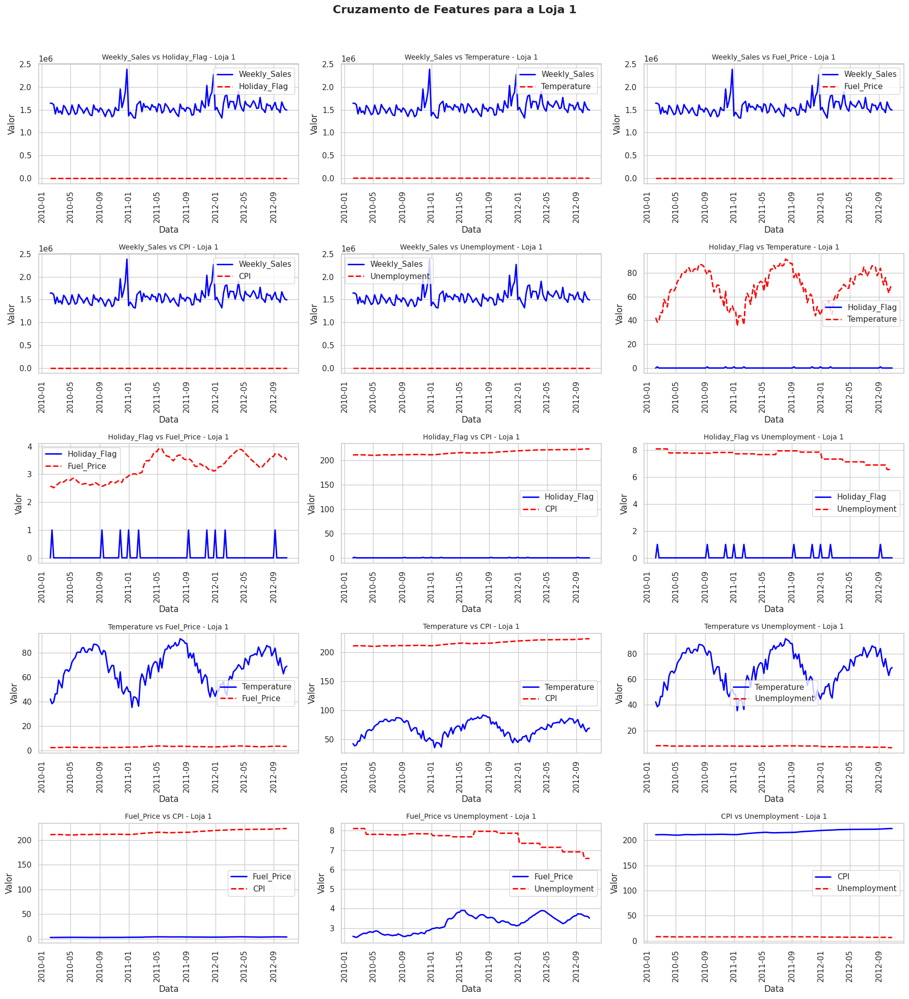

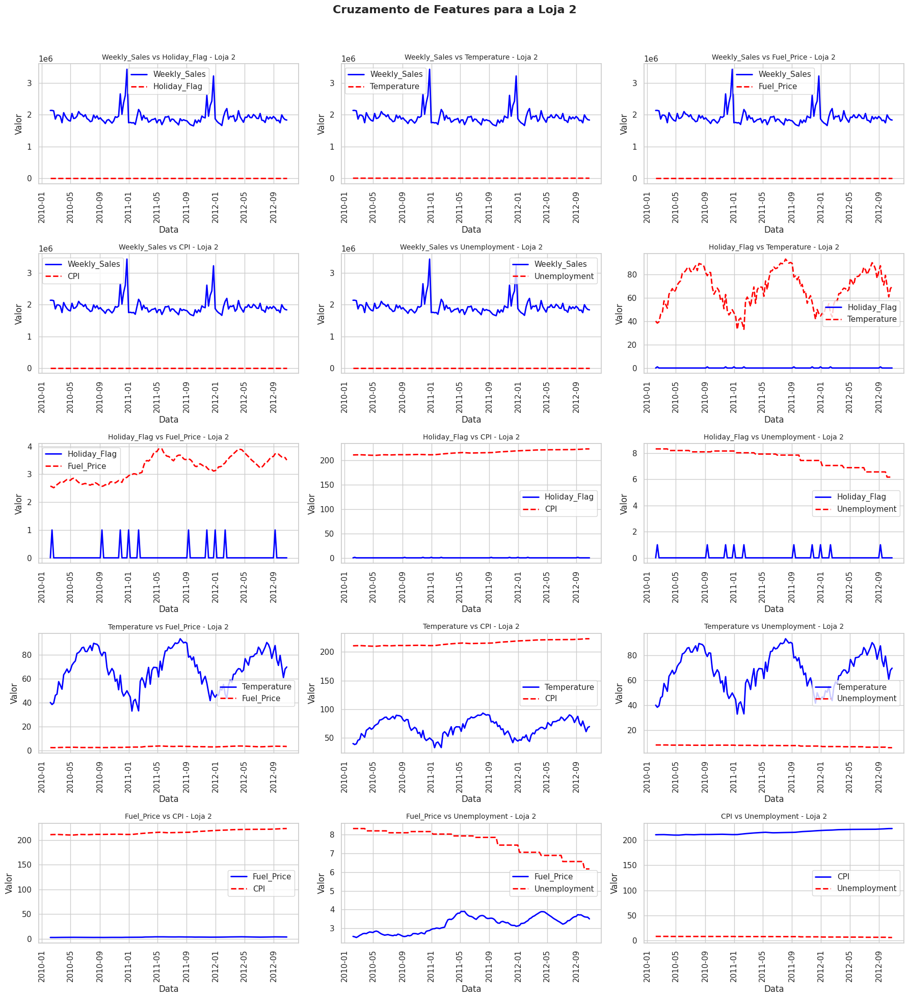

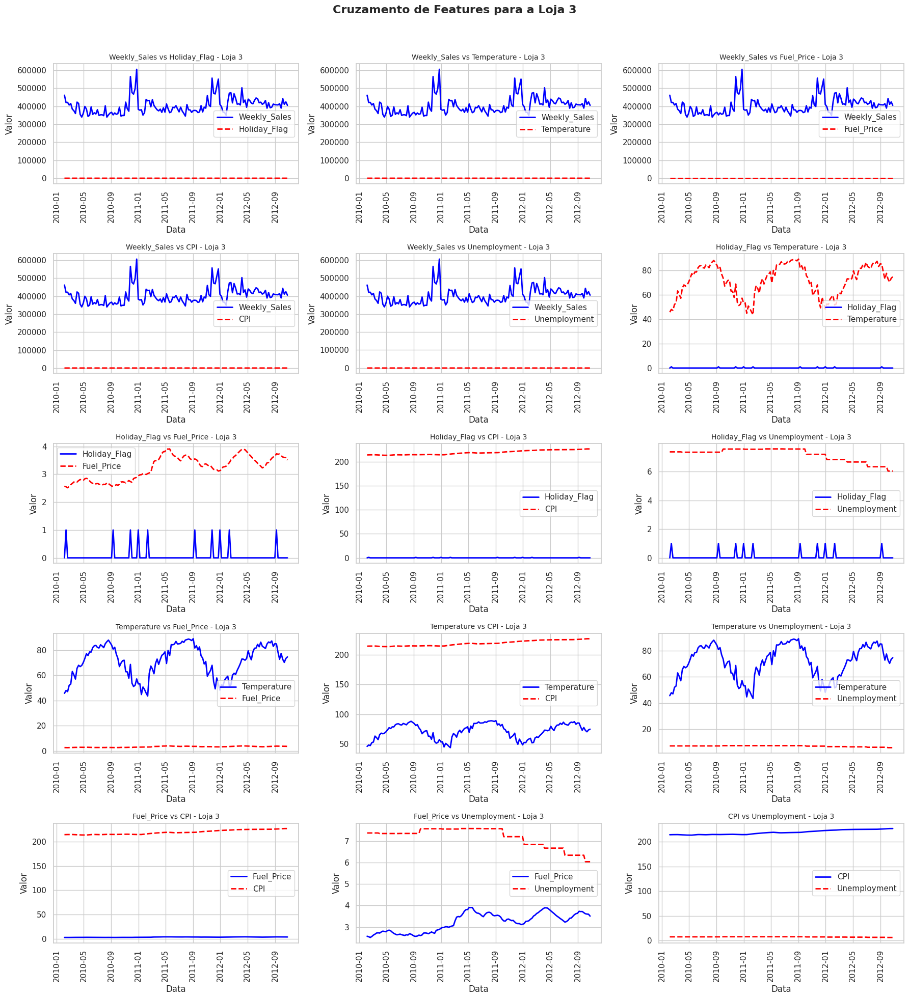

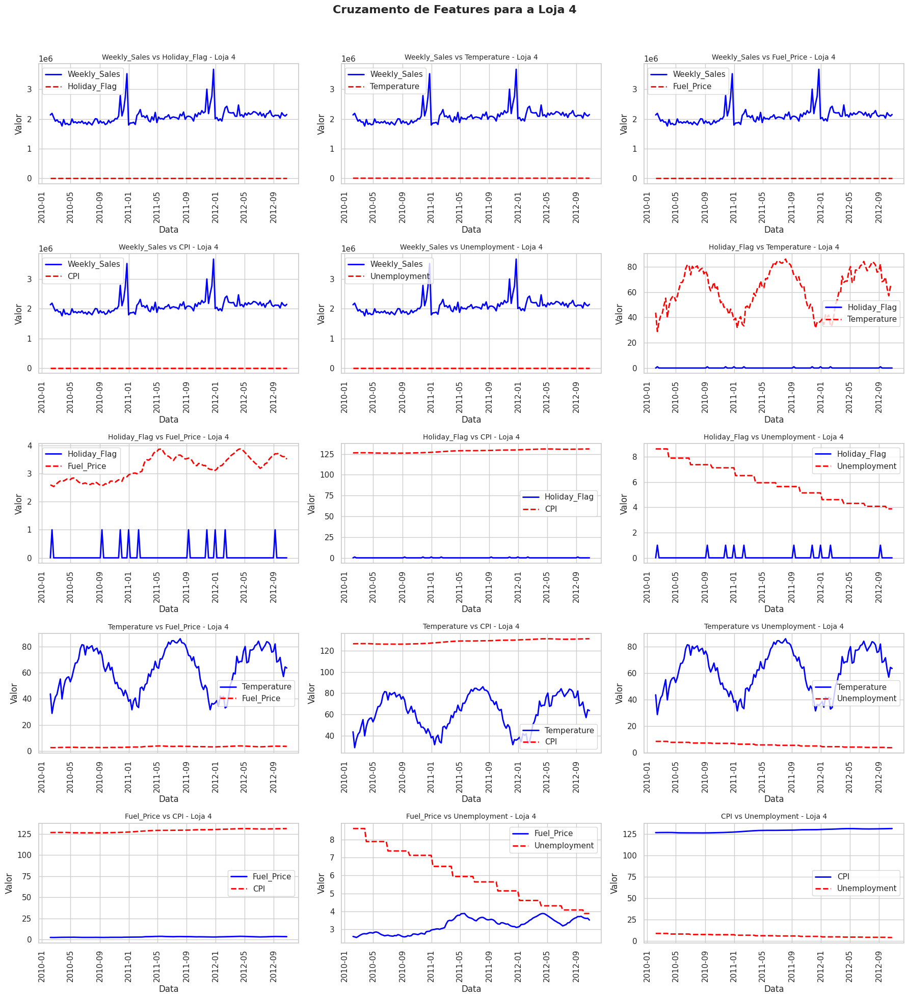

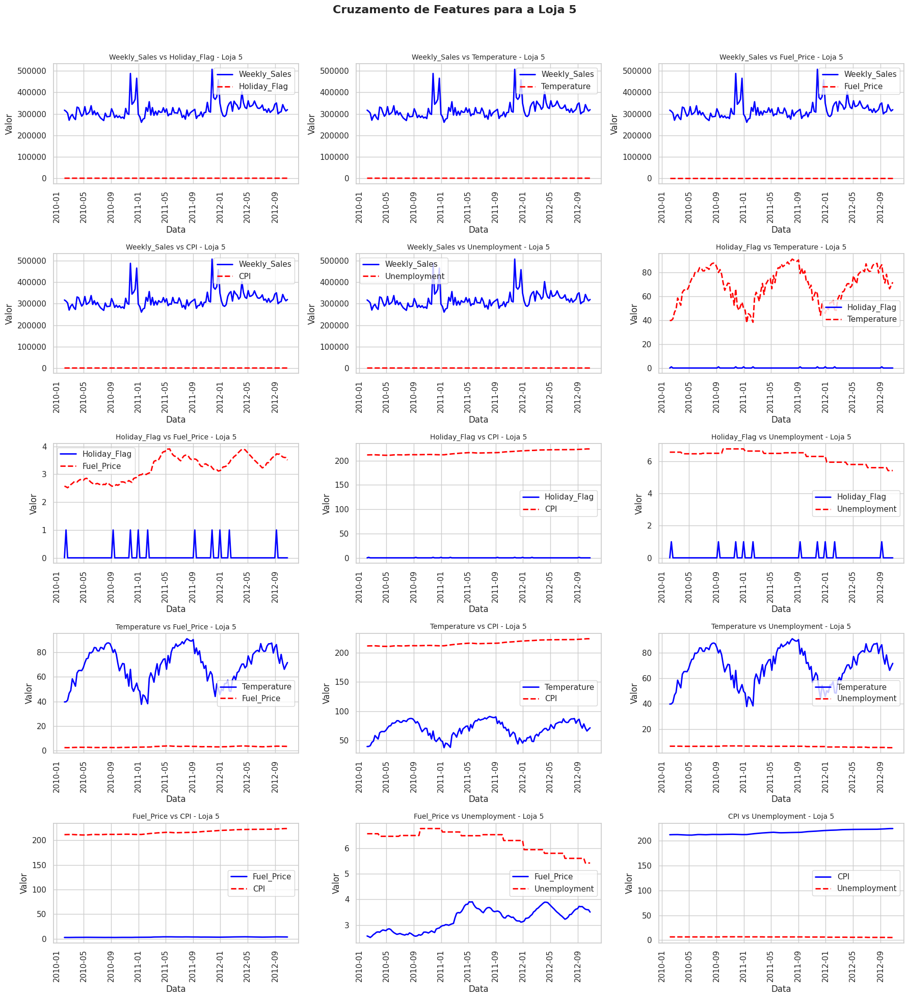

...

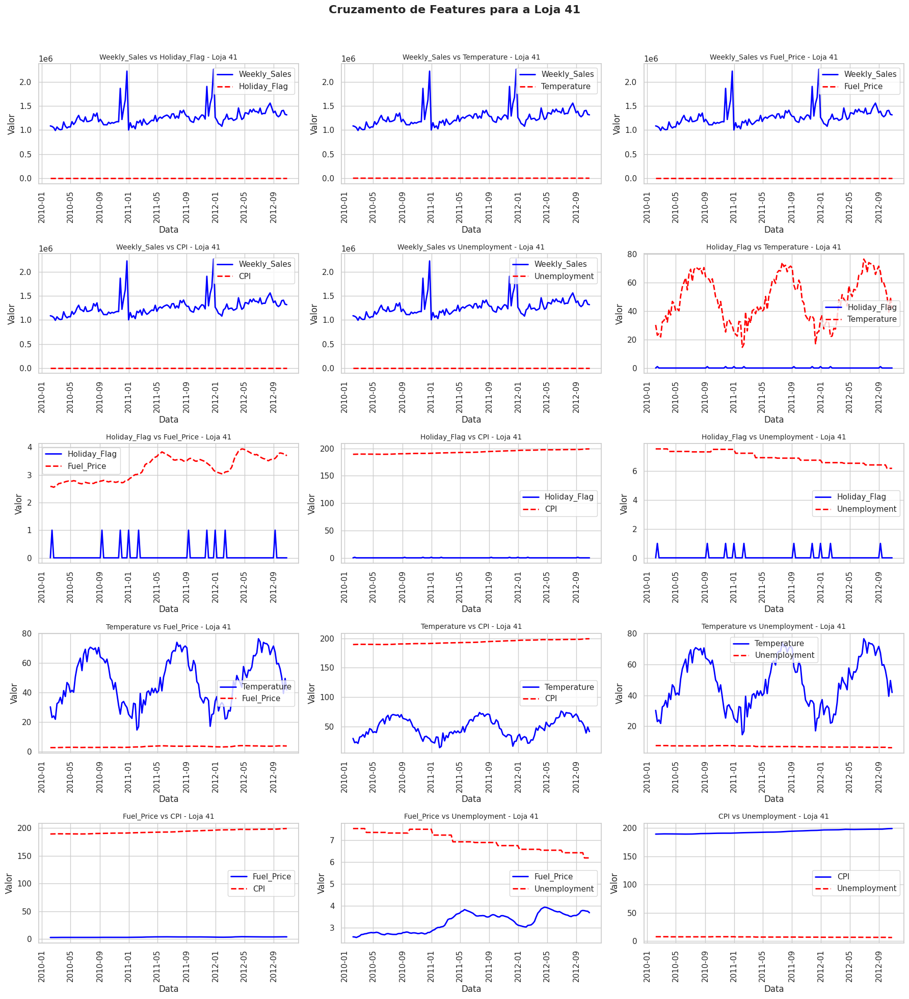

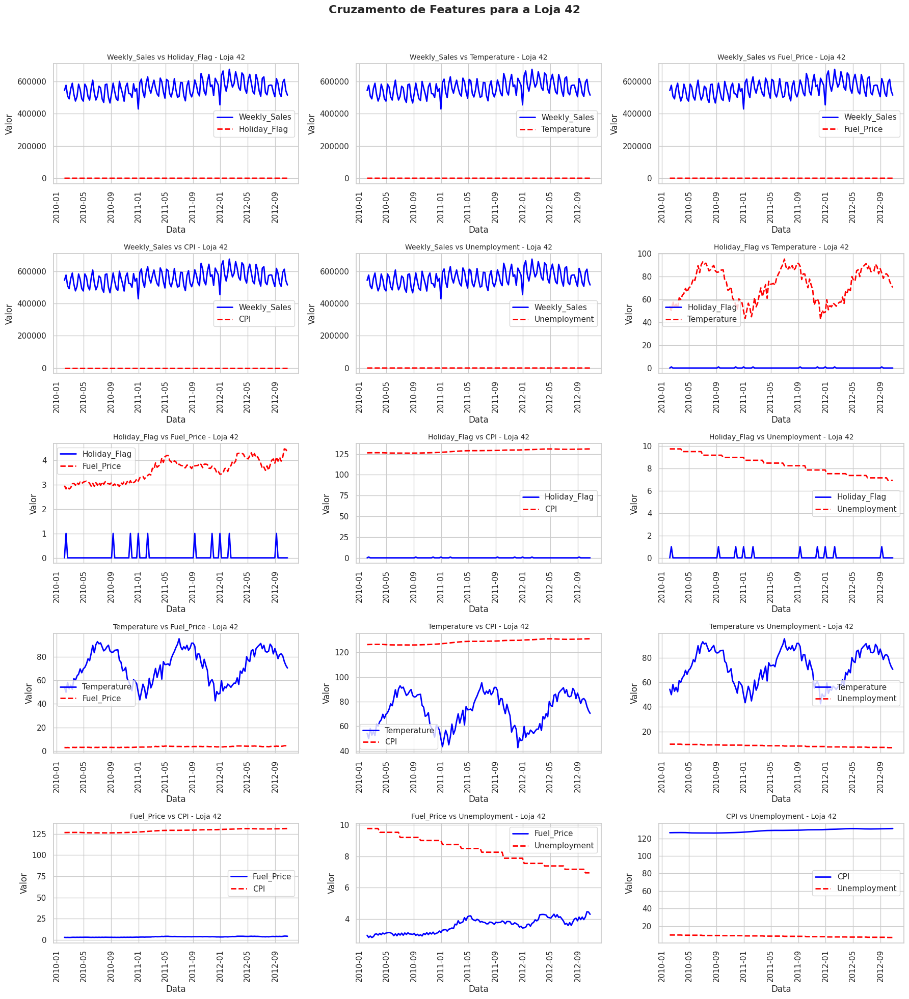

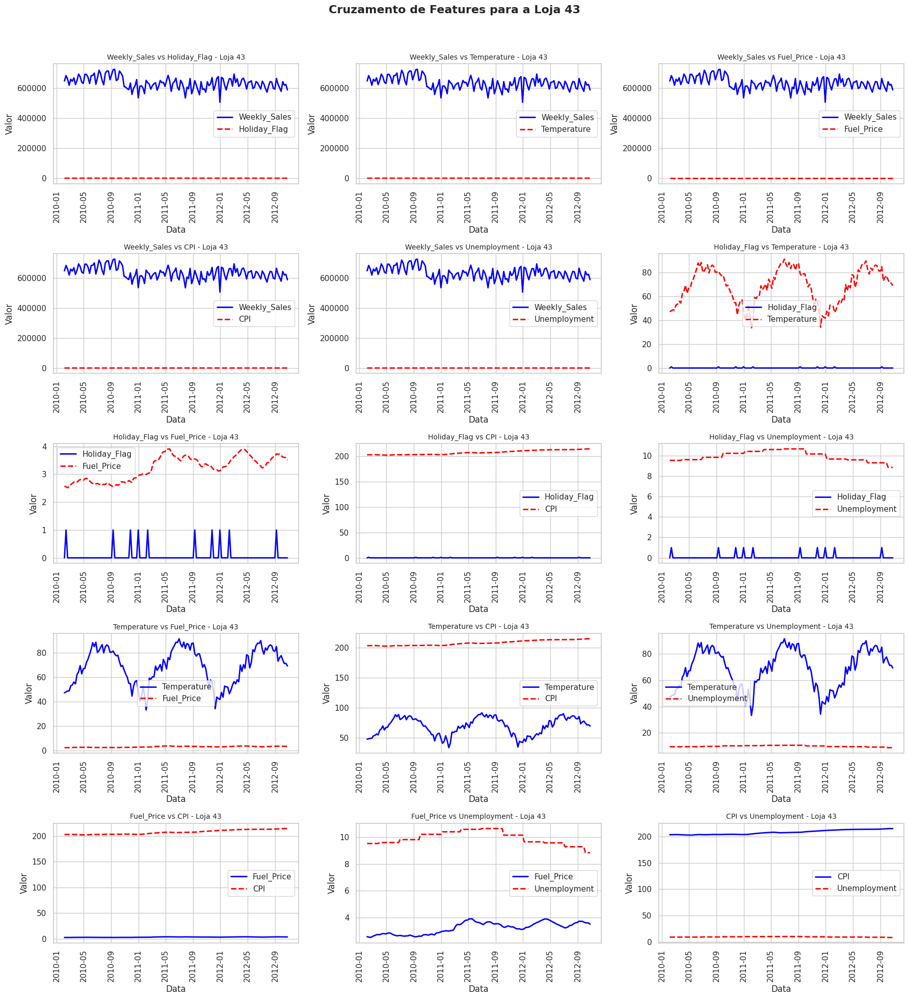

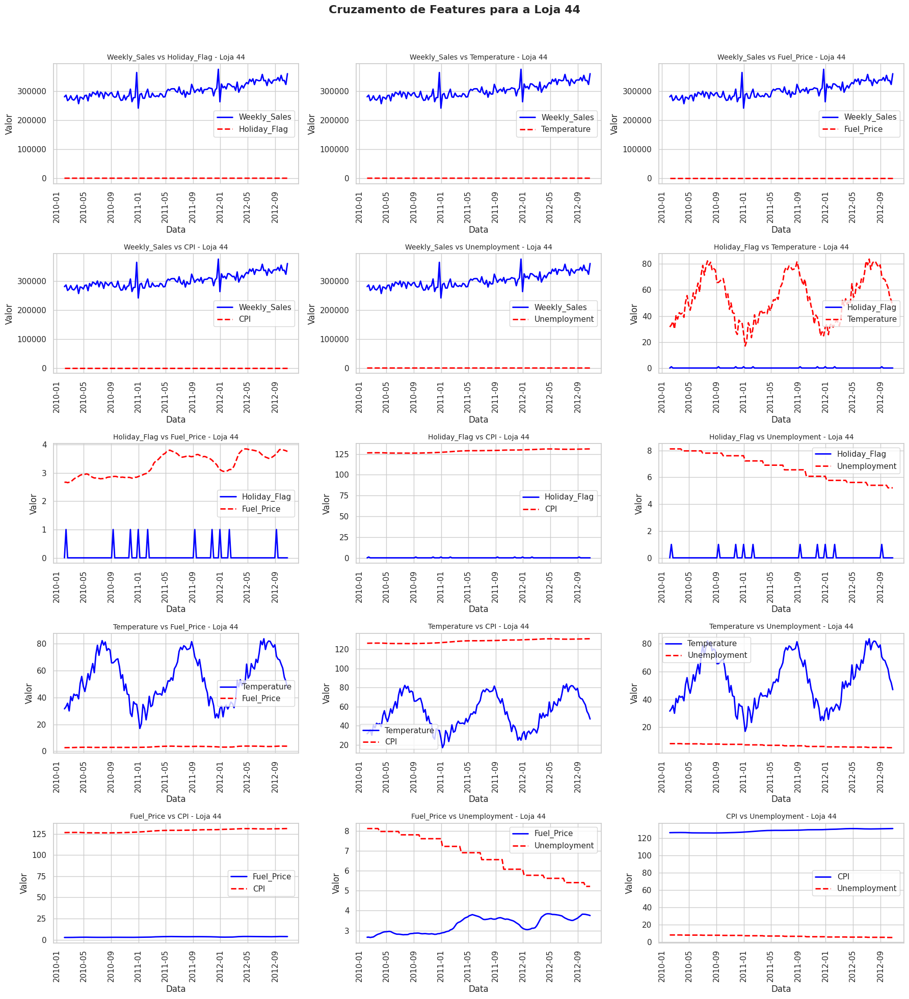

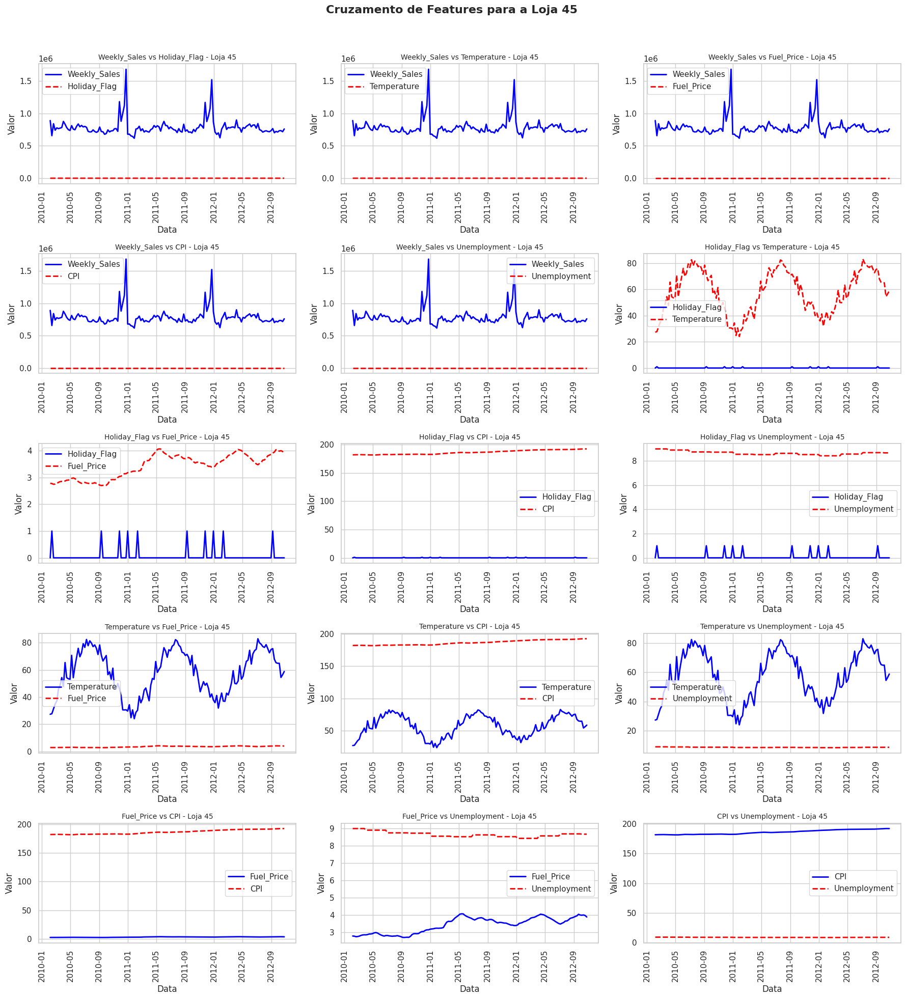

In [152]:
import itertools

sns.set(style="whitegrid")

# Obter a lista de lojas únicas
lojas = df['Store'].unique()

# Definir as features para cruzamento
features = ['Weekly_Sales', 'Holiday_Flag', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']
combinacoes = list(itertools.combinations(features, 2))

# Iterar sobre cada loja
for loja in lojas:
    # Filtrar os dados para a loja atual
    df_loja = df[df['Store'] == loja]

    # Criar subplots organizados
    num_combinacoes = len(combinacoes)
    nrows = num_combinacoes // 3 + (num_combinacoes % 3 > 0)
    fig, axs = plt.subplots(nrows, 3, figsize=(18, nrows * 4))
    axs = axs.flatten()

    # Iterar sobre as combinações de features
    for i, (feat_x, feat_y) in enumerate(combinacoes):
        # Plotar gráfico de linhas apenas se houver dados válidos
        if feat_x in df_loja.columns and feat_y in df_loja.columns:
            sns.lineplot(data=df_loja, x='Date', y=feat_x, ax=axs[i], color='blue', linewidth=2, label=feat_x)
            sns.lineplot(data=df_loja, x='Date', y=feat_y, ax=axs[i], color='red', linewidth=2, linestyle='--', label=feat_y)

            # Definir títulos e rótulos
            axs[i].set_title(f'{feat_x} vs {feat_y} - Loja {loja}', fontsize=10)
            axs[i].set_xlabel('Data')
            axs[i].set_ylabel('Valor')
            axs[i].legend()
            axs[i].tick_params(axis='x', rotation=90)
        else:
            # Remover subplot em branco se houver
            fig.delaxes(axs[i])

    # Ajustar layout e título
    plt.suptitle(f'Cruzamento de Features para a Loja {loja}', fontsize=16, weight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()



**"Análise Multivariada Temporal de Vendas e Fatores Externos para Todas as Lojas"**

### Análise Geral:

O estudo foi realizado para todas as lojas, cruzando múltiplas variáveis relevantes para avaliar os padrões de vendas e a influência de fatores econômicos e sazonais. A seguir, apresento uma análise consolidada dos principais achados:

#### 1. **Impacto dos Feriados nas Vendas (`Weekly_Sales` vs `Holiday_Flag`)**:
- Em quase todas as lojas, os picos de vendas coincidem com a presença de feriados, confirmando que eventos sazonais e promoções afetam significativamente o comportamento de compra.
- As lojas apresentam padrões de aumento nas vendas em semanas de feriado, indicando que campanhas promocionais e descontos são eficazes.

#### 2. **Influência da Temperatura nas Vendas (`Weekly_Sales` vs `Temperature`)**:
- A variação de temperatura não mostra uma correlação clara e consistente com as vendas em todas as lojas. No entanto, em algumas lojas, períodos de alta temperatura coincidem com flutuações nas vendas, sugerindo uma possível influência sazonal.
- As lojas localizadas em regiões com variação climática acentuada podem ter um impacto sazonal maior nas vendas, especialmente em épocas de extremo calor ou frio.

#### 3. **Relação entre Preço do Combustível e Vendas (`Fuel_Price` vs `Weekly_Sales`)**:
- A maioria das lojas não mostra uma relação direta entre o preço do combustível e as vendas semanais. Isso sugere que o preço do combustível, apesar de ser um indicador econômico importante, pode não afetar diretamente o comportamento de compra em lojas de varejo.
- O preço do combustível apresenta variações suaves ao longo do tempo, e as flutuações nas vendas parecem ser mais influenciadas por fatores sazonais do que pelo custo do combustível.

#### 4. **Impacto do CPI e Desemprego nas Vendas (`CPI`, `Unemployment` vs `Weekly_Sales`)**:
- O índice de preços ao consumidor (`CPI`) mostra uma tendência de alta gradual, refletindo a inflação ao longo do período analisado. Em algumas lojas, há uma leve correlação negativa entre o CPI e as vendas, sugerindo que o aumento de preços pode impactar o poder de compra dos consumidores.
- A taxa de desemprego apresenta variações ao longo do tempo, mas sua correlação com as vendas varia entre lojas. Lojas em regiões com alta taxa de desemprego podem ter um desempenho inferior, refletindo o impacto econômico local.

#### 5. **Relações Multivariadas Adicionais**:
- As comparações entre variáveis, como `Temperature` vs `Fuel_Price` e `CPI` vs `Unemployment`, ajudam a identificar tendências econômicas gerais, mas mostram pouca correlação direta com as vendas semanais em nível de loja.
- A relação entre variáveis econômicas, como desemprego e CPI, sugere períodos de crise econômica em algumas regiões, mas o impacto direto nas vendas varia entre lojas.

### Conclusão Geral:
- A análise multivariada revela que o principal fator de impacto nas vendas são os feriados e eventos sazonais, como esperado em um ambiente de varejo.
- Variáveis econômicas, como `CPI` e `Unemployment`, podem influenciar as vendas de forma indireta, especialmente em lojas localizadas em regiões com alta variação desses indicadores.
- A temperatura apresenta influência sazonal, mas sua relação com as vendas varia entre lojas, indicando a necessidade de considerar fatores regionais e climáticos.
- A ausência de uma correlação clara entre o preço do combustível e as vendas sugere que o comportamento de compra nas lojas analisadas é mais influenciado por eventos sazonais e promoções do que por custos externos, como combustível.



---

Dado o contexto do problema e a análise feita até agora, vamos considerar as seguintes observações:

### 1. **Volume de Dados e Problemas de Generalização:**
- O volume de dados parece ser limitado. Em situações com menor quantidade de dados, modelos complexos tendem a sofrer com overfitting, capturando o ruído em vez dos padrões reais.
- A sazonalidade e os efeitos de feriados são evidentes, o que sugere que devemos utilizar um modelo que possa capturar esses padrões temporais.

### 2. **Variáveis Externas e Influência Limitada:**
- Analisamos várias features (e.g., `Temperature`, `Fuel_Price`, `CPI`, `Unemployment`), mas muitas delas não mostraram uma correlação forte e consistente com as vendas semanais.
- As variáveis sazonais, como `Holiday_Flag`, parecem ter um impacto maior nas vendas. Portanto, o modelo deve ser capaz de lidar bem com sazonalidade e eventos específicos.

### 3. **Complexidade e Simplicidade:**
- Modelos complexos, como LSTM ou Gradient Boosting, podem não ser ideais para um dataset pequeno devido ao risco de overfitting e à alta demanda computacional.
- Modelos mais simples, mas que lidam bem com padrões temporais e sazonalidade, tendem a funcionar melhor em situações de dados limitados.

### **Recomendação de Modelo:**

#### **SARIMAX (Seasonal ARIMA with Exogenous Variables)**
- **Motivo**: O SARIMAX é uma boa opção para séries temporais com sazonalidade e permite incluir variáveis exógenas que possam ter um impacto moderado nas vendas (e.g., CPI, Unemployment).
- **Vantagem**: Captura bem a sazonalidade e permite incorporar variáveis externas, oferecendo uma abordagem balanceada.
- **Desvantagem**: Pode ser mais sensível a dados limitados e requer ajustes cuidadosos dos parâmetros.

#### **Modelo Linear Simples (Regressão Linear ou Random Forest com Feature Engineering)**
- **Motivo**: Um modelo linear simples pode ser eficaz ao combinar features selecionadas com base na análise feita (e.g., incluindo `Holiday_Flag`, `Month`, `Temperature`).
- **Vantagem**: Menor risco de overfitting com um volume de dados limitado e mais fácil de interpretar.
- **Desvantagem**: Pode não capturar bem a complexidade da sazonalidade e dos picos de vendas.

### **Decisão Final:**
- Dado o volume limitado de dados e a importância de capturar sazonalidade e efeitos de feriados, recomendo começar com o **Facebook Prophet**. Ele é robusto para séries temporais sazonais e permite fácil inclusão de eventos especiais.
- Se o Prophet não atender às expectativas, o **SARIMAX** é uma boa alternativa, especialmente se você quiser testar a influência das variáveis exógenas (e.g., CPI e Unemployment).
- Como uma abordagem simples e rápida, você pode também testar uma **Regressão Linear** com `Holiday_Flag` e outras variáveis sazonais como baseline, para ter um ponto de comparação.

### Próximos Passos:
1. **Implementar o Prophet**: Ajustar o modelo Prophet para incluir feriados e sazonalidade.
2. **Avaliar Desempenho**: Comparar o desempenho com um modelo baseline simples (Regressão Linear).
3. **Experimentar com SARIMAX**: Testar o SARIMAX se houver evidência de impacto significativo das variáveis exógenas.

Se quiser começar a implementar ou precisa de ajuda com o código, estou aqui para ajudar!

# Iniciando os testes de modelos Regressores
---

## Preparação de Dados para os Modelos

In [153]:
# Criar as colunas Month e Year a partir da coluna Date
df['Month'] = df['Date'].dt.month
df['Year'] = df['Date'].dt.year

# Selecionar as features e a variável alvo
X = df[['Temperature', 'Fuel_Price', 'CPI', 'Unemployment', 'Month', 'Year']]
y = df['Weekly_Sales']

# Dividir os dados em treino e teste
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Verificar as dimensões dos conjuntos de treino e teste
print(X_train.shape, X_test.shape)
print(y_train.shape, y_test.shape)

(4504, 6) (1931, 6)
(4504,) (1931,)


###  Função para testar múltiplos modelos de regressão

In [154]:
# Função para calcular o MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Função para treinar e avaliar múltiplos modelos de regressão
def test_regressors(X_train, X_test, y_train, y_test):
    regressors = {
        'Linear Regression': LinearRegression(),
        'Random Forest': RandomForestRegressor(random_state=42),
        'Decision Tree': DecisionTreeRegressor(random_state=42),
        'Gradient Boosting': GradientBoostingRegressor(random_state=42),
        'Support Vector Regressor': SVR()
    }

    results = {}

    for name, regressor in regressors.items():
        print(f'Treinando {name}:')
        # Treinando o modelo
        regressor.fit(X_train, y_train)
        # Fazer previsões
        y_pred = regressor.predict(X_test)

        # Calcular métricas
        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        mape = mean_absolute_percentage_error(y_test, y_pred)

        # Salvar resultados
        results[name] = {
            'MSE': mse,
            'RMSE': rmse,
            'MAPE': mape
        }

        # Imprimir resultados
        print(f'{name} - MSE: {mse}, RMSE: {rmse}, MAPE: {mape}%')

    return results

In [155]:
resultados = test_regressors(X_train, X_test, y_train, y_test)

Treinando Linear Regression:
Linear Regression - MSE: 310856181038.61346, RMSE: 557544.7794021692, MAPE: 66.00110830959875%
Treinando Random Forest:
Random Forest - MSE: 282626788174.8773, RMSE: 531626.5495391265, MAPE: 49.38474534722127%
Treinando Decision Tree:
Decision Tree - MSE: 397101703080.8656, RMSE: 630160.0614771342, MAPE: 49.57731676148387%
Treinando Gradient Boosting:
Gradient Boosting - MSE: 244684955671.28378, RMSE: 494656.4016277195, MAPE: 57.02707111006844%
Treinando Support Vector Regressor:
Support Vector Regressor - MSE: 330848202684.39386, RMSE: 575194.0565447402, MAPE: 61.01750865666224%


### Importância das Features no Random Forest e Gradient Boosting




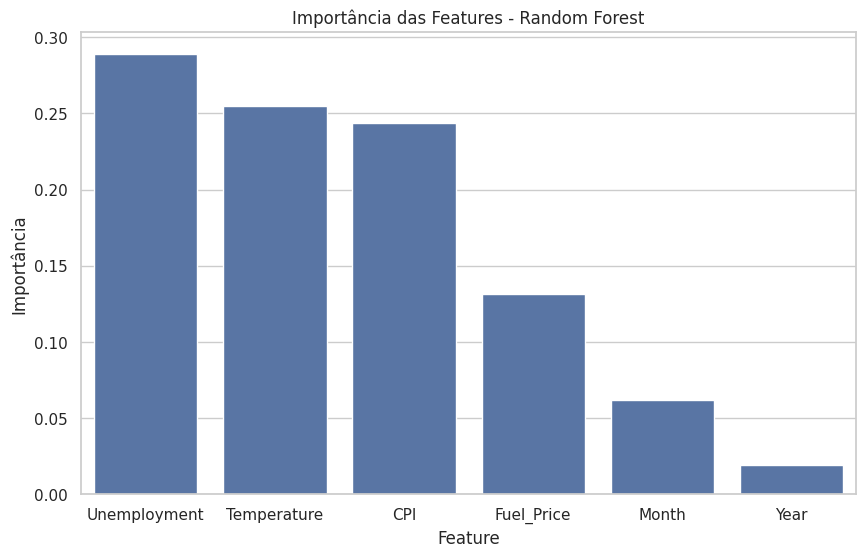

In [156]:
rf_model = RandomForestRegressor(random_state=42)
rf_model.fit(X_train, y_train)

importances = rf_model.feature_importances_

indices = np.argsort(importances)[::-1]

plt.figure(figsize=(10, 6))
sns.barplot(x=X.columns[indices], y=importances[indices])
plt.title("Importância das Features - Random Forest")
plt.xlabel("Feature")
plt.ylabel("Importância")
plt.show()

### Coeficientes no Modelo de Regressão Linear

In [157]:
# Treine o modelo de Regressão Linear
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

# Pegue os coeficientes
coefficients = lr_model.coef_

# Crie um DataFrame para visualizar os coeficientes
coef_df = pd.DataFrame({'Feature': X.columns, 'Coeficiente': coefficients})

# Ordene pelo valor absoluto dos coeficientes
coef_df['Coeficiente_Abs'] = coef_df['Coeficiente'].abs()
coef_df = coef_df.sort_values(by='Coeficiente_Abs', ascending=False)

# Visualizar os coeficientes
print(coef_df)

        Feature   Coeficiente  Coeficiente_Abs
3  Unemployment -44187.509840     44187.509840
1    Fuel_Price  39684.119719     39684.119719
5          Year -36015.096490     36015.096490
4         Month  14074.618959     14074.618959
2           CPI  -1450.786930      1450.786930
0   Temperature  -1282.199561      1282.199561


### Recursive Feature Elimination (RFE)

In [158]:
# Usando Gradient Boosting
model = GradientBoostingRegressor(random_state=42)
rfe = RFE(model, n_features_to_select=5)
rfe = rfe.fit(X_train, y_train)

print("Features Selecionadas:", X_train.columns[rfe.support_])

for i in range(len(rfe.support_)):
    print(f'Feature {X_train.columns[i]}: {"Selecionada" if rfe.support_[i] else "Eliminada"}')

Features Selecionadas: Index(['Temperature', 'Fuel_Price', 'CPI', 'Unemployment', 'Month'], dtype='object')
Feature Temperature: Selecionada
Feature Fuel_Price: Selecionada
Feature CPI: Selecionada
Feature Unemployment: Selecionada
Feature Month: Selecionada
Feature Year: Eliminada


### SHAP Values (SHapley Additive exPlanations)

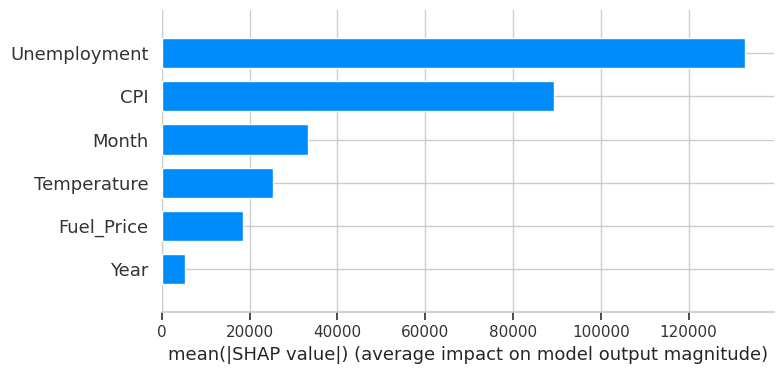

In [159]:
model = GradientBoostingRegressor()
model.fit(X_train, y_train)

explainer = shap.Explainer(model)
shap_values = explainer(X_test)

shap.summary_plot(shap_values, X_test, plot_type="bar")

#### Aprimorarando as Features
Seleção de Features Baseadas no SHAP

In [160]:
# Selecionando apenas as features mais importantes com base no gráfico SHAP
X_selected = df[['Unemployment', 'CPI', 'Month', 'Temperature']]

# Dividindo os dados em treino e teste novamente com as features selecionadas
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.3, random_state=42)

#### Tuning dos Modelos
Ajustando Hiperparâmetros para Random Forest

In [161]:
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
}

rf = RandomForestRegressor(random_state=42)

grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2)
grid_search.fit(X_train, y_train)

print("Melhores hiperparâmetros:", grid_search.best_params_)

Fitting 3 folds for each of 108 candidates, totalling 324 fits
Melhores hiperparâmetros: {'max_depth': 20, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 200}


#### Validação Cruzada (K-fold Cross-Validation)

In [162]:
best_rf = grid_search.best_estimator_
cv = 5
cv_scores = cross_val_score(best_rf, X_train, y_train, cv=cv, scoring='neg_mean_squared_error')

print(f"Média do MSE nas {cv} folds: {-cv_scores.mean()}")
print(f"Desvio padrão do MSE nas {cv} folds: {cv_scores.std()}")

Média do MSE nas 5 folds: 230380354689.38736
Desvio padrão do MSE nas 5 folds: 17114201932.836409


#### Visualização das Previsões
Gráfico de Comparação entre Previsões e Valores Reais

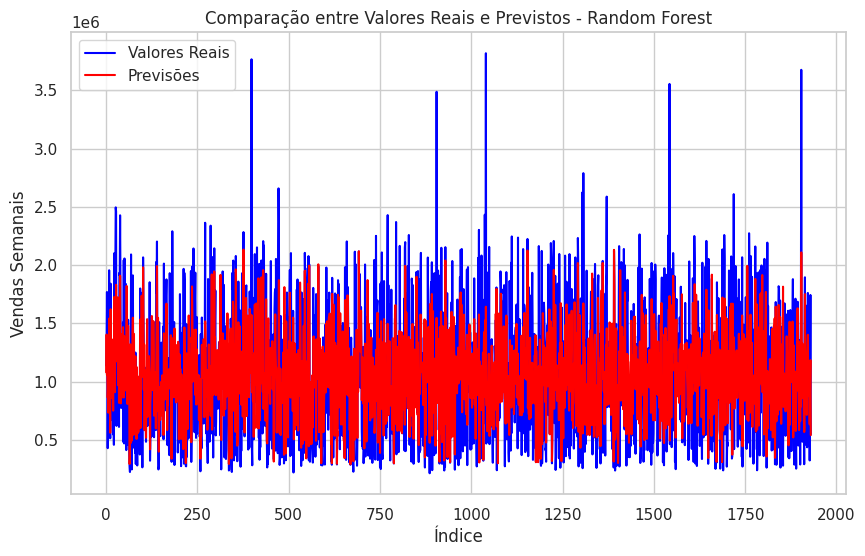

In [163]:
# Treinar o modelo e fazer previsões
best_rf.fit(X_train, y_train)
y_pred = best_rf.predict(X_test)

# Comparação entre valores reais e previstos
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Valores Reais', color='blue')
plt.plot(y_pred, label='Previsões', color='red')
plt.legend()
plt.title('Comparação entre Valores Reais e Previstos - Random Forest')
plt.xlabel('Índice')
plt.ylabel('Vendas Semanais')
plt.show()

#### Explorar Impacto Temporal
Gráfico de Comparação Temporal (para CPI e Unemployment)

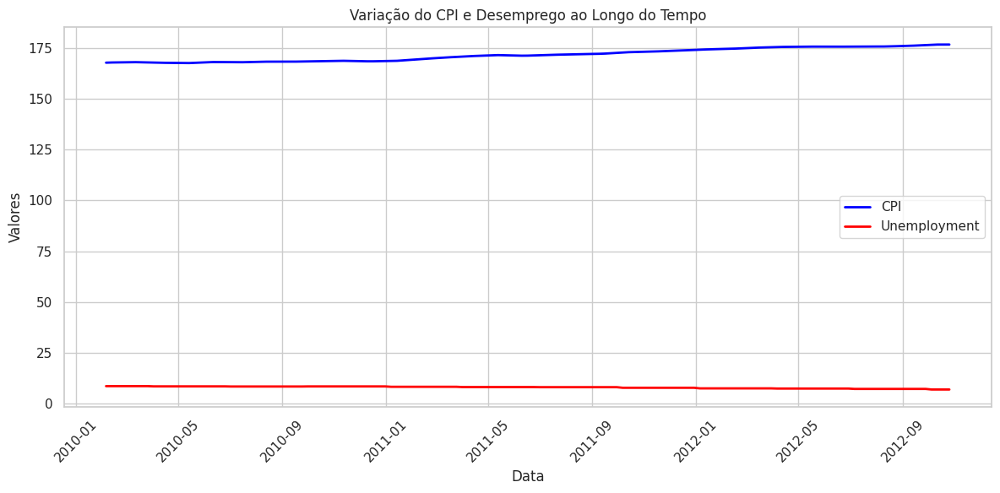

In [164]:
# Agrupar os dados por data e calcular a média
df_grouped = df.groupby('Date')[['CPI', 'Unemployment']].mean().reset_index()

# Criar o gráfico
plt.figure(figsize=(12, 6))
plt.plot(df_grouped['Date'], df_grouped['CPI'], label='CPI', color='blue', linewidth=2)
plt.plot(df_grouped['Date'], df_grouped['Unemployment'], label='Unemployment', color='red', linewidth=2)

# Adicionar título e rótulos
plt.title('Variação do CPI e Desemprego ao Longo do Tempo')
plt.xlabel('Data')
plt.ylabel('Valores')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()

# Exibir o gráfico
plt.show()



**Análise dos Gráficos:**

#### Gráfico 1: **Comparação entre Valores Reais e Previstos - Random Forest**
- **Observação Geral**: O gráfico mostra a comparação entre os valores reais (azul) e as previsões (vermelho) feitas pelo modelo Random Forest.
- **Comportamento do Modelo**:
  - As previsões feitas pelo modelo Random Forest parecem seguir uma faixa bem definida e menos volátil em comparação com os valores reais.
  - Os valores reais apresentam uma maior variação e picos significativos, enquanto as previsões são mais suaves e tendem a não capturar bem os picos mais altos.
- **Problema Identificado**:
  - O modelo apresenta uma **subestimação dos picos de vendas**, indicando que não conseguiu capturar bem os outliers e eventos sazonais, possivelmente devido à falta de variáveis exógenas suficientes para explicar essas variações extremas.
  - Há um ajuste razoável para os valores médios, mas falha na captura das flutuações extremas.
- **Conclusão**:
  - O modelo Random Forest está conseguindo capturar parte do padrão geral das vendas, mas precisa de ajustes para lidar melhor com os picos de demanda.
  - Poderia ser útil incluir variáveis adicionais ou aumentar o número de árvores no modelo para melhorar a captura das variações extremas.

#### Gráfico 2: **Variação do CPI e Desemprego ao Longo do Tempo**
- **Observação Geral**: O gráfico mostra a evolução temporal do índice de preços ao consumidor (`CPI`, em azul) e da taxa de desemprego (`Unemployment`, em vermelho).
- **Comportamento das Variáveis**:
  - O `CPI` apresenta uma tendência de alta consistente ao longo do tempo, refletindo a inflação e o aumento gradual dos preços ao consumidor. A linha é suave, indicando um crescimento contínuo e estável.
  - A taxa de desemprego, por outro lado, apresenta uma linha quase plana, com pequenas variações, indicando uma relativa estabilidade no nível de desemprego durante o período analisado.
- **Problema Identificado**:
  - A falta de variação na taxa de desemprego pode sugerir que esta variável não tem uma influência significativa nas previsões de vendas, pelo menos para este período específico.
  - A tendência de alta do `CPI` poderia estar relacionada a uma leve queda no poder de compra dos consumidores, mas o impacto direto nas vendas precisa ser analisado em conjunto com outras variáveis.
- **Conclusão**:
  - O impacto do `CPI` pode ser mais relevante para períodos de longo prazo, afetando o comportamento de compra devido ao aumento dos preços. No entanto, a taxa de desemprego não apresenta variação suficiente para ser um preditor forte neste caso.
  - Pode ser interessante testar a exclusão da taxa de desemprego do modelo, considerando seu baixo impacto e pouca variação, para simplificar o modelo e melhorar a performance.

---

# <b>SARIMAX </b>


## # Criando processamento de métricas para cada loja sem gráficos

In [224]:
# Carregar o dataset a partir do URL
url = 'https://raw.githubusercontent.com/guilherminog/tcc_timeseries/main/dataset/Walmart.csv'
df_smax = pd.read_csv(url)

# Converter a coluna 'Date' para o tipo datetime
df_smax['Date'] = pd.to_datetime(df_smax['Date'], dayfirst=True)

# Obter a lista de lojas
stores = df_smax['Store'].unique()

# Criar um dataframe para armazenar as métricas de desempenho
results = pd.DataFrame(columns=['Store', 'MSE', 'RMSE', 'MAE', 'MAPE', 'R2'])

# Iterar sobre cada loja
for store in stores:
    print(f'\nProcessando a Loja {store}...')

    # Selecionar dados da loja atual
    df_store = df_smax[df_smax['Store'] == store].copy()

    # Ordenar os dados por data
    df_store = df_store.sort_values('Date')

    # Configurar a coluna 'Date' como índice
    df_store.set_index('Date', inplace=True)

    # Selecionar as colunas relevantes
    endog = df_store['Weekly_Sales']
    exog = df_store[['Holiday_Flag', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']]

    # Aplicar transformação logarítmica
    endog_log = np.log(endog)

    # Dividir os dados em treino e teste
    train_size = int(len(endog_log) * 0.8)
    endog_train, endog_test = endog_log.iloc[:train_size], endog_log.iloc[train_size:]
    exog_train, exog_test = exog.iloc[:train_size], exog.iloc[train_size:]

    # Verificar se há dados suficientes para treino e teste
    if len(endog_train) < 10 or len(endog_test) < 10:
        print(f'A Loja {store} não possui dados suficientes para treinamento e teste. Pulando...')
        continue

    # Definir os parâmetros do modelo
    order = (2, 1, 2)
    seasonal_order = (1, 1, 1, 52)

    try:
        # Ajustar o modelo
        model = sm.tsa.SARIMAX(endog_train, exog=exog_train, order=order, seasonal_order=seasonal_order)
        model_fit = model.fit(disp=False)

        # Fazer previsões
        predictions_log = model_fit.predict(start=endog_test.index[0], end=endog_test.index[-1], exog=exog_test)

        # Reverter a transformação logarítmica
        predictions = np.exp(predictions_log)
        actual = endog.iloc[train_size:]

        # Calcular as métricas de erro
        mse = np.mean((predictions - actual) ** 2)
        rmse = np.sqrt(mse)
        mae = np.mean(np.abs(predictions - actual))
        mape = np.mean(np.abs((actual - predictions) / actual)) * 100

        # Calcular R²
        r2 = r2_score(actual, predictions)

        # Criar um DataFrame com os resultados da loja atual
        new_row = pd.DataFrame({
            'Store': [store],
            'MSE': [mse],
            'RMSE': [rmse],
            'MAE': [mae],
            'MAPE': [mape],
            'R2': [r2]
        })

        # Concatenar o novo DataFrame ao DataFrame de resultados
        results = pd.concat([results, new_row], ignore_index=True)

        print(f'Loja {store}: MAPE={mape:.2f}%, R²={r2:.4f}')

    except Exception as e:
        print(f'Erro ao processar a Loja {store}: {e}')
        continue

# Exibir os resultados finais
print('\nResultados Finais:')
print(results)


Processando a Loja 1...
Loja 1: MAPE=5.51%, R²=-0.5832

Processando a Loja 2...
Loja 2: MAPE=2.67%, R²=0.1554

Processando a Loja 3...
Loja 3: MAPE=6.79%, R²=-2.6885

Processando a Loja 4...
Loja 4: MAPE=3.48%, R²=-1.8867

Processando a Loja 5...
Loja 5: MAPE=5.23%, R²=-0.5417

Processando a Loja 6...
Loja 6: MAPE=12.85%, R²=-3.1416

Processando a Loja 7...
Loja 7: MAPE=5.67%, R²=0.8068

Processando a Loja 8...
Loja 8: MAPE=7.42%, R²=-6.4950

Processando a Loja 9...
Loja 9: MAPE=10.57%, R²=-4.9857

Processando a Loja 10...
Loja 10: MAPE=4.87%, R²=-1.2320

Processando a Loja 11...
Loja 11: MAPE=5.48%, R²=-0.5778

Processando a Loja 12...
Loja 12: MAPE=7.90%, R²=-1.4932

Processando a Loja 13...
Loja 13: MAPE=9.90%, R²=-8.7043

Processando a Loja 14...
Loja 14: MAPE=19.75%, R²=-3.4567

Processando a Loja 15...
Loja 15: MAPE=8.04%, R²=-0.4823

Processando a Loja 16...
Loja 16: MAPE=5.38%, R²=0.6589

Processando a Loja 17...
Loja 17: MAPE=8.42%, R²=-0.4069

Processando a Loja 18...
Loja 1

## Análise dos Resultados do Modelo SARIMAX nas 45 Lojas

Como analista de dados, vou analisar os resultados obtidos do modelo SARIMAX aplicado às 45 lojas, focando nas métricas MAPE (Mean Absolute Percentage Error) e R² (Coeficiente de Determinação). O objetivo é identificar padrões de desempenho, possíveis problemas e sugerir melhorias para o modelo.

---

**1. Visão Geral dos Resultados**

Os resultados apresentam o MAPE e o R² para cada uma das 45 lojas:

- **MAPE** varia de **2.38%** a **21.93%**.
- **R²** varia de **0.8068** a **-17.5472**.

Essas métricas nos permitem avaliar a precisão das previsões do modelo e o quanto ele explica a variabilidade dos dados.

---
**2. Análise do MAPE**

**2.1. Distribuição do MAPE**

- **MAPE Médio**: Aproximadamente **7.54%**.
- **Lojas com MAPE < 5%**: Lojas **2**, **4**, **21**, **24**, **26**, **27**, **31**, **33**, **34**, **36**, **37**, **41**, **43**, **44**.
- **Lojas com MAPE entre 5% e 10%**: Maioria das lojas.
- **Lojas com MAPE > 10%**: Lojas **6**, **9**, **13**, **14**, **18**, **20**, **22**, **35**, **38**, **45**.

**2.2. Interpretação**

- **MAPE < 5%**: Excelente precisão nas previsões.
- **MAPE entre 5% e 10%**: Boa precisão, mas pode haver espaço para melhorias.
- **MAPE > 10%**: Desempenho insatisfatório, indicando que o modelo não está capturando bem os padrões de vendas nessas lojas.

---

**3. Análise do R²**

**3.1. Distribuição do R²**

- **R² Positivo**: Lojas **2**, **7**, **16**, **21**, **23**, **24**, **26**, **27**, **33**, **36**, **41**, **42**.
- **R² Próximo de Zero**: Lojas **2**, **21**, **23**, **24**, **26**, **27**, **33**, **36**, **41**, **42**.
- **R² Negativo**: A maioria das lojas apresenta R² negativo, com valores variando até **-17.5472**.

**3.2. Interpretação**

- **R² Positivo Próximo de 1**: O modelo explica bem a variabilidade dos dados (não é o caso aqui, pois o maior R² é **0.8068**).
- **R² Próximo de Zero**: O modelo não explica a variabilidade melhor do que a média dos dados.
- **R² Negativo**: O modelo está pior do que uma simples média dos dados, indicando inadequação do modelo para essas lojas.

---

**4. Correlação entre MAPE e R²**

- **Lojas com MAPE baixo e R² positivo**: Indicam bom desempenho do modelo (ex.: Loja 7).
- **Lojas com MAPE baixo e R² negativo**: Contradição aparente; embora o erro percentual seja baixo, o modelo não está explicando bem a variabilidade dos dados.
- **Lojas com MAPE alto e R² negativo**: Desempenho ruim, modelo não está adequado (ex.: Loja 45).

---

**5. Identificação de Lojas com Desempenho Destacado**

**5.1. Melhor Desempenho**

- **Loja 37**: MAPE **2.38%**, R² **-0.2104**.
- **Loja 34**: MAPE **2.69%**, R² **-0.4912**.
- **Loja 2**: MAPE **2.67%**, R² **0.1554**.
- **Loja 4**: MAPE **3.48%**, R² **-1.8867**.

**5.2. Pior Desempenho**

- **Loja 45**: MAPE **21.93%**, R² **-17.5472**.
- **Loja 22**: MAPE **15.78%**, R² **-14.3308**.
- **Loja 35**: MAPE **19.72%**, R² **-10.4483**.
- **Loja 13**: MAPE **9.90%**, R² **-8.7043**.

---

**6. Possíveis Razões para Desempenho Variável**

**6.1. Lojas com MAPE Alto e R² Muito Negativo**

- **Inadequação do Modelo**: O modelo SARIMAX pode não estar capturando corretamente os padrões de vendas nessas lojas.
- **Dados Anômalos**: Presença de outliers, mudanças estruturais ou eventos especiais não modelados.
- **Sazonalidade Diferente**: As lojas podem ter sazonalidades específicas não capturadas pelo modelo padrão.

**6.2. Lojas com MAPE Baixo e R² Negativo**

- **Baixa Variabilidade nos Dados**: Mesmo com MAPE baixo, se a variabilidade nas vendas for pequena, o R² pode ser negativo.
- **Overfitting**: O modelo pode estar ajustando bem os dados de treino, mas não generalizando para os dados de teste.

---

**7. Conclusão**

A análise dos resultados indica que o modelo SARIMAX com parâmetros fixos não é igualmente eficaz para todas as lojas. Enquanto algumas lojas apresentam desempenho aceitável, outras têm resultados insatisfatórios, sugerindo a necessidade de ajustes.

**Principais Pontos:**

- **Variabilidade nos Resultados**: Há uma grande variação no desempenho entre as lojas.
- **Necessidade de Ajustes Individuais**: Ajustar os modelos individualmente pode melhorar a precisão das previsões.
- **Importância da Análise Exploratória**: Compreender os padrões específicos de cada loja é essencial para modelagem eficaz.

---

## **Considerações Finais**

A previsão de vendas é um desafio complexo que requer uma abordagem personalizada para cada contexto. Ao adaptar os modelos às características individuais de cada loja e ao explorar diferentes técnicas, é possível melhorar significativamente a precisão das previsões e, consequentemente, apoiar decisões estratégicas mais assertivas.


## Definindo Metricas para cada Loja e Verificando os dados Reais com os Previsões


Processando a Loja 1...
Processando a Loja 2...
Processando a Loja 3...
Processando a Loja 4...
Processando a Loja 5...
Processando a Loja 6...
Processando a Loja 7...
Processando a Loja 8...
Processando a Loja 9...
Processando a Loja 10...
Processando a Loja 11...
Processando a Loja 12...
Processando a Loja 13...
Processando a Loja 14...
Processando a Loja 15...
Processando a Loja 16...
Processando a Loja 17...
Processando a Loja 18...
Processando a Loja 19...
Processando a Loja 20...
Processando a Loja 21...
Processando a Loja 22...
Processando a Loja 23...
Processando a Loja 24...
Processando a Loja 25...
Processando a Loja 26...
Processando a Loja 27...
Processando a Loja 28...
Processando a Loja 29...
Processando a Loja 30...
Processando a Loja 31...
Processando a Loja 32...
Processando a Loja 33...
Processando a Loja 34...
Processando a Loja 35...
Processando a Loja 36...
Processando a Loja 37...
Processando a Loja 38...
Processando a Loja 39...
Processando a Loja 40...
Processan

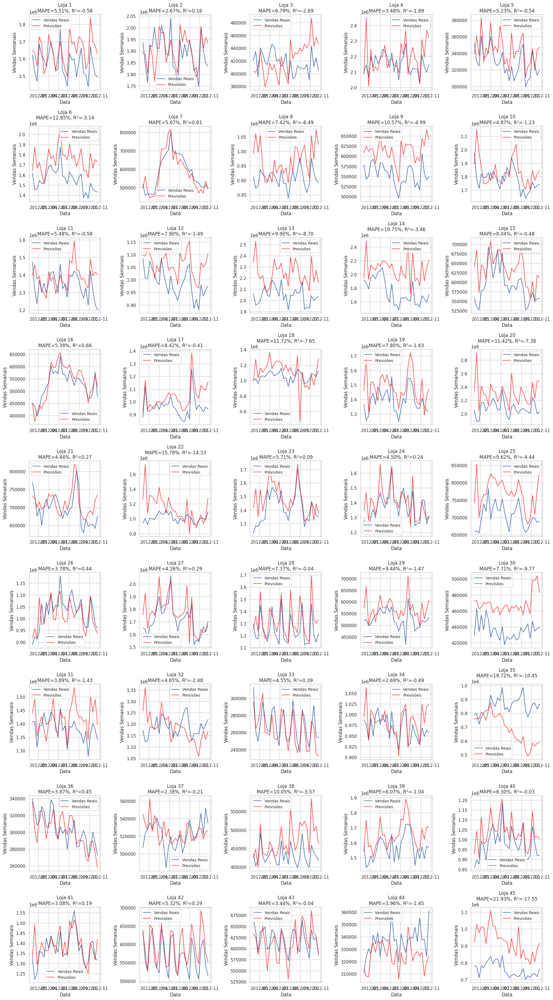

In [225]:
# Definir o número de linhas e colunas para o grid de plots
nrows = 9
ncols = 5

# Criar a figura e os eixos
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 36))  # Ajuste o figsize conforme necessário

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Iterar sobre cada loja e eixo correspondente
for idx, store in enumerate(stores):
    print(f'Processando a Loja {store}...')

    # Selecionar dados da loja atual
    df_store = df_smax[df_smax['Store'] == store].copy()

    # Ordenar os dados por data
    df_store = df_store.sort_values('Date')

    # Configurar a coluna 'Date' como índice
    df_store.set_index('Date', inplace=True)

    # Selecionar as colunas relevantes
    endog = df_store['Weekly_Sales']
    exog = df_store[['Holiday_Flag', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']]

    # Aplicar transformação logarítmica
    endog_log = np.log(endog)

    # Dividir os dados em treino e teste
    train_size = int(len(endog_log) * 0.8)
    endog_train, endog_test = endog_log.iloc[:train_size], endog_log.iloc[train_size:]
    exog_train, exog_test = exog.iloc[:train_size], exog.iloc[train_size:]

    # Verificar se há dados suficientes para treino e teste
    if len(endog_train) < 10 or len(endog_test) < 10:
        print(f'A Loja {store} não possui dados suficientes para treinamento e teste. Pulando...')
        continue

    # Definir os parâmetros do modelo
    order = (2, 1, 2)
    seasonal_order = (1, 1, 1, 52)

    try:
        # Ajustar o modelo
        model = sm.tsa.SARIMAX(endog_train, exog=exog_train, order=order, seasonal_order=seasonal_order)
        model_fit = model.fit(disp=False)

        # Fazer previsões
        predictions_log = model_fit.predict(start=endog_test.index[0], end=endog_test.index[-1], exog=exog_test)

        # Reverter a transformação logarítmica
        predictions = np.exp(predictions_log)
        actual = endog.iloc[train_size:]

        # Calcular as métricas de erro
        mse = np.mean((predictions - actual) ** 2)
        rmse = np.sqrt(mse)
        mae = np.mean(np.abs(predictions - actual))
        mape = np.mean(np.abs((actual - predictions) / actual)) * 100

        # Calcular R²
        r2 = r2_score(actual, predictions)

        # Plotar no subplot correspondente
        ax = axes[idx]
        ax.plot(actual.index, actual, label='Vendas Reais')
        ax.plot(predictions.index, predictions, label='Previsões', color='red', alpha=0.7)
        ax.set_title(f'Loja {store}\nMAPE={mape:.2f}%, R²={r2:.2f}')
        ax.set_xlabel('Data')
        ax.set_ylabel('Vendas Semanais')
        ax.legend(fontsize='small')

    except Exception as e:
        print(f'Erro ao processar a Loja {store}: {e}')
        continue

# Remover subplots extras se houver
for i in range(idx+1, nrows*ncols):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


# LSTM

In [200]:
url = "https://raw.githubusercontent.com/guilherminog/tcc_timeseries/refs/heads/main/dataset/Walmart.csv"

df_lstm = pd.read_csv(url)
df_lstm['Date'] = pd.to_datetime(df_lstm['Date'], format='%d-%m-%Y')

In [201]:
df_lstm.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106


## Lojas

Nós precisamos adaptar o dataset para cada loja. O timeseries recebido pelo LSTM precisa conter uma continuidade clara e consisa.
Se utilizarmos o dataset contendo todo o histórico de vendas de todas as lojas, o modelo LSTM não conseguirá aprender a sazonalidade de cada loja individualmente, e a ordem da sazonalidade confundirá.

Podemos também realizar uma abordagem de juntar as lojas num unico dataframe, utilizando dados agregados de todas as lojas e fazendo média/soma nos valores quando apropriado apra agregá-los.  
As lojas possuem vários outros fatores que envolvem suas vendas, como localização, tamanho, concorrência local, performance de funcionários, disposição dos itens etc.  
Portanto parece mais apropriado que o modelo LSTM aprenda sobre a loja para uma previsão mais precisa.  
  
Nosso dataset possui  6435 semanas e 45 lojas, o que deixaria o treino do modelo preditivo para cada loja com poucos dados de treinamento, já que temos apenas dados de 143 semanas para cada loja.  
Desta forma, se escolhermos 70% do tamanho do nosso dataset, teremos approx 100 semanas para treino, o que é um número muito pequeno para um modelo LSTM e provavelmente não teríamos bons resultados.

Se optarmos pela abordagem de juntar todas as lojas e agregar seus valores, não teremos uma diferença no tamanho do dataset e ficaremos com o mesmo número de treino.  
Para sermos capazes de treinar um modelo LSTM de forma que nos aproveitemos de todas as lojas para o treino e do maior numero de dados possíveis, precisamos buscar uma abordagem diferente.

Entender a sazonalidade dos dados é a tarefa principal do nosso LSTM. Por ser multivariado, podemos treinar o modelo a detectar a magnitude da sazonalidade pelas features.
Para conter o maior número de dados possíveis, abriremos mão de precisão entre lojas, e criaremos um modelo único que servirá para qualquer loja. Algumas apresentarão resultados melhores que outras, mas o modelo será capaz de prever vendas de qualquer loja.
Vamos seguir com esta estratégia, mas clusterizar as lojas primeiro e executar um diferente fit para cada cluster pode se provar mais apropriado.

In [202]:
stores_count = df_lstm['Store'].nunique()
print(f'Total de lojas: {stores_count}')
print(f'Total de semanas: {len(df_lstm)}')
print(f'Total de semanas para cada loja: {len(df_lstm) / stores_count}')

Total de lojas: 45
Total de semanas: 6435
Total de semanas para cada loja: 143.0


## Corte de datas e divisão dos dados de treino e teste
Vamos separar pelo menos 1 ano para dados de treino, e manter o restante para teste.

Nosso dataset começa em fevereiro, então pode ser uma boa ideia avançar um pouco mais garantirmos que temos um ano completo de dados.   

O superbowl é em fevereiro, o dia do trabalho em setembro, ação de graças em novembro e natal em dezembro.  
Se usarmos um ano a partir de fevereiro, vamos ter o superbowl duas vezes, mas todos os outros feriados apenas uma vez.   
Para compensar um pouco e ajudar a dispersar o erro que o superbowl vai causar, podemos adicionar mais algumas semanas no nosso treino, evitando a páscoa para não repetirmos o problema.

Aproveito para deixar algumas variáveis aqui também a fim de facilitar ajustes finos de acordo com resultados obtidos.

In [203]:
epochs = 100
activation_model = 'tanh'
new_scaler = StandardScaler()

target = 'Weekly_Sales'
variables = [target] + ['Holiday_Flag', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']

first_date = df_lstm['Date'].min()
last_date = df_lstm['Date'].max()
total_weeks = (last_date - first_date).days / 7
weeks_in_year = 365 // 7
total_weeks_train_cutoff = weeks_in_year + 8
total_weeks_train = total_weeks_train_cutoff - 1

end_train_date = first_date + pd.DateOffset(weeks=total_weeks_train_cutoff)

df_train = df_lstm[df_lstm['Date'] < end_train_date]
df_test = df_lstm[df_lstm['Date'] >= end_train_date]

print(f'Primeira data: {first_date}')
print(f'Última data: {last_date}')
print(f'Total de semanas: {total_weeks}')
print(f'Total de semanas num ano: {weeks_in_year}')
print(f'Data de corte escolhida: {end_train_date}')
print(f'\nTotal semanas de treino: {len(df_train)}')
print(f'Total semanas de teste: {len(df_test)}')


Primeira data: 2010-02-05 00:00:00
Última data: 2012-10-26 00:00:00
Total de semanas: 142.0
Total de semanas num ano: 52
Data de corte escolhida: 2011-04-01 00:00:00

Total semanas de treino: 2700
Total semanas de teste: 3735


# Definindo formato dos testes e resultados
Essa é talvez a tarefa mais importante do forecast por LSTM.  
O formato dos dados dirá ao modelo como ele efetivamente deve se comportar em seu treino, tal como também define o formato do nosso input para obter previsões futuras.

Como previamente decidimos que o modelo irá usar um número N de semanas para se basear, precisamos então treiná-lo com este mesmo número de semanas por vez.
Podemos então montar um input com formato (lojas, N, features) para treinar o modelo. Desta forma, teremos 48 treinos (numero de lojas) com N semanas de dados.

Logo, para obter uma previsão num cenário de uso real do modelo, precisamos pedir ao usuário que diga-nos todas as informações das últimas N semanas que aconteceram para que seja possível prever qual será a Weekly_Sales da próxima. Veremos isto durante o predict em breve.

Nosso output Y é a Weekly_Sales da próxima semana, já que gostaríamos de prever somente Weekly_Sales e mais nenhum valor, o formato de Y será (lojas, 1).

### Primeiro, separamos o X_train e o Y_train
Nosso y_train terá a previsão que o LSTM "deveria" ter feito da loja para ser capaz de ser treinado.

Será a semana seguinte à última semana de cada loja que usaremos para treino.  
Para isso, removemos do df_train a ultima semana de cada loja e separamos em um segundo dataframe.

Note que o tamanho de y_train é o número de lojas, e o tamanho de x_train é o número de lojas * numero de semanas de treino

In [205]:
last_week_for_y_train = df_train['Date'].max()

y_train = df_train[df_train['Date'] >= last_week_for_y_train]
x_train = df_train[df_train['Date'] < last_week_for_y_train]

print(f"len(y_train) = lojas? {len(y_train) == stores_count}")
print(f"len(x_train) = lojas * semanas treino? {len(x_train) == stores_count * total_weeks_train}")
print(f"Total de lojas para treino foi distibuído corretamente? {len(x_train) + len(y_train) == len(df_train)}")

print(f"\nshape x_train: {x_train.shape}")
print(f"shape y_train: {y_train.shape}")

len(y_train) = lojas? True
len(x_train) = lojas * semanas treino? True
Total de lojas para treino foi distibuído corretamente? True

shape x_train: (2655, 8)
shape y_train: (45, 8)


### Deixando os dataframes somente com as variaveis que iremos usar

In [206]:
x_train_shaped = x_train.sort_values(['Store', 'Date'], ascending=[True, True])[variables]
y_train_shaped = y_train.sort_values(['Store', 'Date'], ascending=[True, True])[variables]

print(f"shape x_train: {x_train_shaped.shape}")
print(f"shape y_train: {y_train_shaped.shape}")

shape x_train: (2655, 6)
shape y_train: (45, 6)


### Aplicando a normalização
As funções de ativação tahn e sigmoid são sensíveis à magnitude dos dados, então é uma boa ideia aplicarmos um scaler para normalizar os dados.  
new_scaler fica como variáveil para facilitar ajustes finos futuros.

O scaler precisa de todos os dados par normalizar corretamente, incluindo nossa coluna Y. Portanto, vamos juntar as duas depois separamos novamente.  
Não podemos fazer isto antes porque precisamos da coluna Date pra separar X_train e Y_train, e nossas variáveis não contam com ela.  
 Logo, se aplicarmos o scaler antes, perdemos os dados e também erramos na normalização.

In [208]:
new_scaler = StandardScaler()

df_to_scale = pd.concat([x_train_shaped, y_train_shaped], ignore_index=True)
df_scaled = scaler.fit_transform(df_to_scale)

y_train_scaled = df_scaled[len(x_train):]
x_train_scaled = df_scaled[:len(x_train)]

print(f"shape x_train: {x_train_scaled.shape}")
print(f"shape y_train: {y_train_scaled.shape}")

shape x_train: (2655, 6)
shape y_train: (45, 6)


### Aplicando o formato
Não conseguimos usar nossas funções de um dataframe comum aqui pois passamos a ter dados normalizados.  
Felizmente, ordenamos anteriormente, então podemos usufruir da ordem para montar o formato que queremos (lojas, semanas_treino, n_variaveis)  
Digamos que semanas_treino = 10. Se obtermos os 10 primeiros itens de x_train_scaled, este será todos os dados de treino da loja 1.  

In [209]:
x_train_aux = []
for i in range (1, stores_count+1):
    x_train_aux.append(x_train_scaled[(i-1) * total_weeks_train:i * total_weeks_train])

# target é a primeira variável, definimos anteriormente a ordem das colunas no script
# então podemos usar a ordem para manipular a y_train
y_train_aux = []
for i in range (0, len(y_train_scaled)):
    y_train_aux.append(y_train_scaled[i][0])

x_train_final, y_train_final = np.array(x_train_aux), np.array(y_train_aux)

print(f"x_train_final shape {x_train_final.shape}")
print(f"y_train_final shape {y_train_final.shape}")

x_train_final shape (45, 59, 6)
y_train_final shape (45,)


## Definindo o modelo

In [219]:
model = keras.models.Sequential()

model.add(LSTM(128, activation=activation_model, input_shape=(x_train_final.shape[1], x_train_final.shape[2]), return_sequences=True,))
model.add(LSTM(32, activation=activation_model, return_sequences=False))
model.add(Dense(1))

model.compile(optimizer='adam', loss='mse')
model.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_4 (LSTM)                        │ (None, 59, 128)             │          69,120 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_5 (LSTM)                        │ (None, 32)                  │          20,608 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 89,761 (350.63 KB)

 Trainable params: 89,761 (350.63 KB)

 Non-trainable params: 0 (0.00 B)

### Fitting

Epoch 1/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 42ms/step - loss: 0.0192 - val_loss: 0.0026
Epoch 2/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - loss: 0.0032 - val_loss: 6.8023e-04
Epoch 3/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - loss: 0.0011 - val_loss: 7.9363e-04
Epoch 4/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - loss: 5.8540e-04 - val_loss: 6.5984e-04
Epoch 5/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - loss: 9.0519e-04 - val_loss: 6.7601e-04
Epoch 6/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - loss: 7.0343e-04 - val_loss: 2.7478e-04
Epoch 7/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - loss: 5.9705e-04 - val_loss: 6.0496e-04
Epoch 8/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - loss: 2.8977e-04 - val_loss: 1.0315e-04
Epoch 9/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - loss: 1.6154e-04 - val_loss: 2.2604e-04
Epoch 10/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - loss: 5.2358e-04 - val_loss: 0.0010
Epoch 11/100
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - loss: 0.0013 - val_loss:

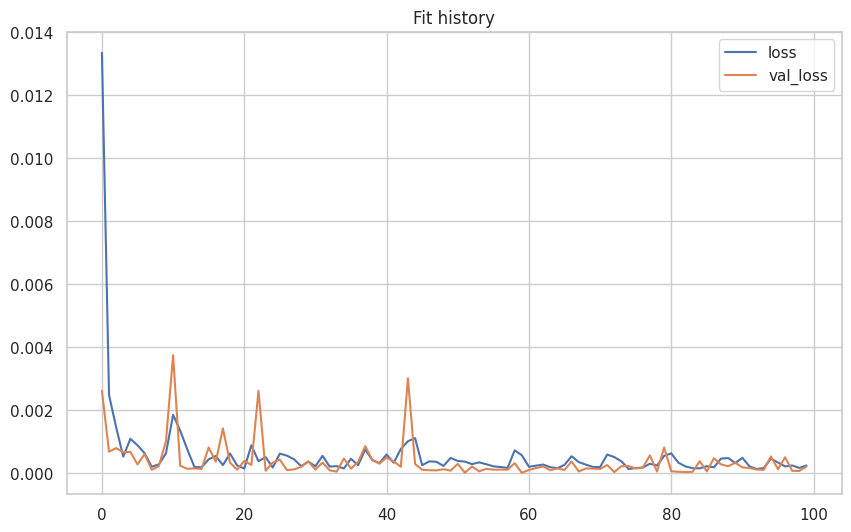

In [220]:
history = model.fit(x_train_final, y_train_final, epochs=epochs, batch_size=1, validation_split=0.1, verbose=1)

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.title('Fit history')
plt.legend()
plt.show()

In [221]:
# para fazer o forecast precisamos agora trabalhar com todos os dados que não trabalhamos antes quando separamos dataframes de treino e teste.
# vamos fazer o mesmo processo de normalização e formatação para os dados de teste.
# depois desnormalizamos para comparar.


# precisamos de 59 semanas anteriores para prever a próxima.
# vamos fazer isso várias vezes para uma loja apenas para visualizarmos como fica, depois executamos para todas lojas.

def predict_for_store(store_number):
    df_store_test = df_test[df_test['Store'] == store_number].sort_values(['Date'], ascending=[True])
    df_store_complete = df[df['Store'] == store_number].sort_values(['Date'], ascending=[True])
    y_test = df_store_test[target]
    x_test = []

    for _, row in df_store_test.iterrows():
        # busca itens anterioes ao atual de df_store_test
        # adiciona o resultado ao final de x_test
        past_weeks = df_store_complete[df_store_complete['Date'] < row['Date']].tail(total_weeks_train)
        normalized = scaler.transform(past_weeks[variables])
        x_test.append(normalized)

    x_test = np.array(x_test)
    y_pred = model.predict(x_test)

    # para conserguirmos desnormalizar, precisamos que o nosso y_pred esteja no mesmo formato que o scaler teve o fit.
    # vamos transformar  o y_pred só para atender o tamanho correto do scaler
    y_pred = np.repeat(y_pred, len(variables), axis=1)
    y_pred = scaler.inverse_transform(y_pred)[:,0]
    return y_pred, y_test

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 159ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
3/3 ━━━━━━━

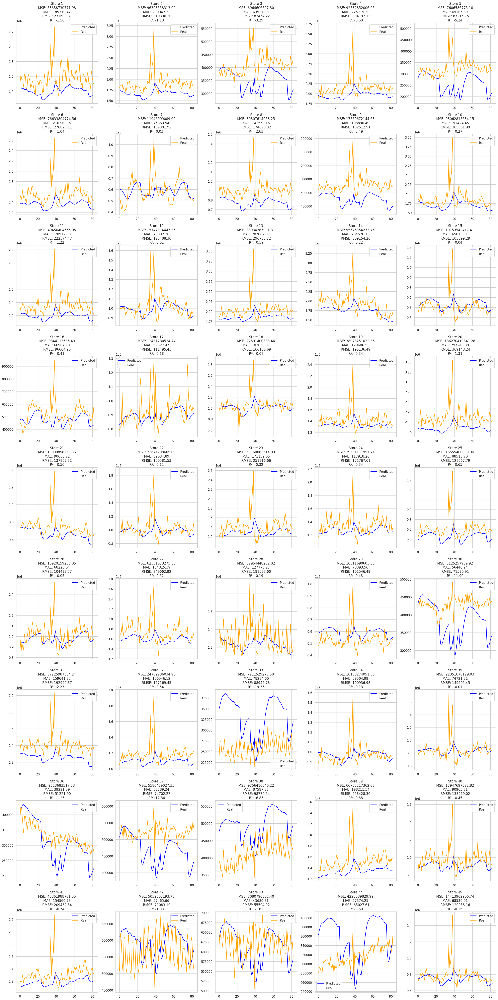

In [222]:
# Definição das métricas
def calculate_metrics(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_true, y_pred)
    return mse, mae, rmse, r2

# Configurações para os gráficos
fig, axes = plt.subplots(nrows=9, ncols=5, figsize=(25, 50))
axes = axes.flatten()

# Loop para cada loja
for i in range(1, stores_count + 1):
    y_pred, y_test = predict_for_store(i)

    # Calcular as métricas
    mse, mae, rmse, r2 = calculate_metrics(y_test.values, y_pred)

    # Título do gráfico com as métricas em linhas separadas
    title = (
        f"Store {i}\n"
        f"MSE: {mse:.2f}\n"
        f"MAE: {mae:.2f}\n"
        f"RMSE: {rmse:.2f}\n"
        f"R²: {r2:.2f}"
    )

    # Selecionar o eixo para plotagem
    ax = axes[i - 1]
    ax.plot(y_pred, label='Predicted', color='blue')
    ax.plot(y_test.values, label='Real', color='orange')
    ax.set_title(title)
    ax.legend()

# Ajustar layout
plt.tight_layout()
plt.show()